In [1]:
### EP2MAC0417/MAC5768
##################################################################
# AO PREENCHER ESSE CABEÇALHO COM O MEU NOME E O MEU NÚMERO USP, #
# DECLARO QUE SOU O ÚNICO AUTOR E RESPONSÁVEL PELA RESOLUÇÃO     #
# DESTE EP.                                                      #
# TODAS AS PARTES FORAM DESENVOLVIDAS E IMPLEMENTADAS POR MIM,   #
# SEGUINDO AS INSTRUÇÕES E QUE PORTANTO, NÃO CONSTITUEM          #
# DESONESTIDADE ACADÊMICA OU PLÁGIO.                             #
#                                                                #
# DECLARO TAMBÉM, QUE SOU RESPONSÁVEL POR TODAS AS CÓPIAS        #
# DESSE PROGRAMA, E QUE EU NÃO DISTRIBUI OU FACILITEI A          #
# SUA DISTRIBUIÇÃO. ESTOU CIENTE QUE OS CASOS DE PLÁGIO E        #
# DESONESTIDADE ACADÊMICA SERÃO TRATADOS SEGUNDO OS CRITÉRIOS    #
# DEFINIDOS NO CÓDIGO DE ÉTICA DA USP.                           #
#                                                                #
# ENTENDO QUE JUPYTER NOTEBOOKS SEM ASSINATURA NÃO SERÃO         #
# CORRIGIDOS E, AINDA ASSIM, PODERÃO SER PUNIDOS POR             #
# DESONESTIDADE ACADÊMICA.                                       #
#                                                                #
#                                                                #
# Nome: MARCUS VINICIUS FUGAGNOLI LARANJEIRA                     #
# NUSP: 5383459                                                  #
# Turma: MAC 0417/5768                                           #
# Prof.: Ronaldo Fumio Hashimoto                                 #
##################################################################

# EP 2 - Parte 2

Marcus Vinicius Fugagnoli Laranjeira - Número USP 5383459

In [2]:
import os
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from cv2 import imwrite

## Parte 0: Carga dos Metadados e Parâmetros do Notebook
### Parte 0.1: Metadados

In [3]:
# Caminho para o subdiretório das imagens
ogdir = 'originalGrayDataset'
agdir = 'augmentedDataset'
nmdir = 'normalizedDataset'
subdirs = ['contrast_stretching',
          'log_transform',
          'exp_transform',
          'laplacian_img',
          'mean_img']

In [4]:
metadados = pd.read_csv('metadados_completo.csv')

In [5]:
display(metadados.head(5))
display(metadados.tail(5))

,Grupo,Descrição,Nome Arquivo,Classe 1,Classe 2,Classe 3,Plano de Fundo,Luz,Ambiente,Média Histograma,Mediana Histograma,Brilho
0,1,"Lâmpada, Post-It, Chave de Fenda",0001.png,Lâmpada,Post-It,Chave de Fenda,Madeira,Amarela,Interno,131,131,Equilibrado
1,1,"Lâmpada, Post-It, Cadeado",0002.png,Lâmpada,Post-It,Cadeado,Madeira,Amarela,Interno,131,131,Equilibrado
2,1,"Lâmpada, Post-It, Rolha",0003.png,Lâmpada,Post-It,Rolha,Madeira,Amarela,Interno,131,131,Equilibrado
3,1,"Lâmpada, Post-It, Pincel",0004.png,Lâmpada,Post-It,Pincel,Madeira,Amarela,Interno,131,131,Equilibrado
4,1,"Lâmpada, Post-It, Caneta",0005.png,Lâmpada,Post-It,Caneta,Madeira,Amarela,Interno,131,131,Equilibrado


,Grupo,Descrição,Nome Arquivo,Classe 1,Classe 2,Classe 3,Plano de Fundo,Luz,Ambiente,Média Histograma,Mediana Histograma,Brilho
595,5,"Pincel, Pinça, Pendrive",0596.png,Pincel,Pinça,Pendrive,Pedra,Sol,Externo,246,254,Claro
596,5,"Caneta, Pilha, Pinça",0597.png,Caneta,Pilha,Pinça,Pedra,Sol,Externo,246,254,Claro
597,5,"Caneta, Pilha, Pendrive",0598.png,Caneta,Pilha,Pendrive,Pedra,Sol,Externo,246,254,Claro
598,5,"Caneta, Pinça, Pendrive",0599.png,Caneta,Pinça,Pendrive,Pedra,Sol,Externo,246,254,Claro
599,5,"Pilha, Pinça, Pendrive",0600.png,Pilha,Pinça,Pendrive,Pedra,Sol,Externo,246,254,Claro


### Parte 0.2: Criação / Limpeza dos diretórios de destino

In [6]:
def limpa_dir(directory):
    for filename in os.listdir(directory):
        file_path = os.path.join(directory, filename)
        try:
            if os.path.isfile(file_path) or os.path.islink(file_path):
                os.unlink(file_path)  # Remove o arquivo/link
            elif os.path.isdir(file_path):
                # Deletar o conteúdo (recursivo)
                for root, dirs, files in os.walk(file_path, topdown = False):
                    for name in files:
                        os.remove(os.path.join(root, name))
                    for name in dirs:
                        os.rmdir(os.path.join(root, name))
                os.rmdir(file_path)
        except Exception as e:
            print(f'Erro ao deletar {file_path}. Motivo: {e}')

In [7]:
diretorios = ['.\\' + nmdir + '\\', '.\\' + os.path.join(nmdir, ogdir), '.\\' + os.path.join(nmdir, agdir)]
for subdir in subdirs:
    diretorios.append('.\\' + os.path.join(os.path.join(nmdir, agdir), subdir + '\\'))

for diretorio in diretorios:
    if os.path.exists(diretorio):
        # Se o diretório existir, deletar todo o conteúdo dele
        limpa_dir(diretorio)
        print(f'Diretório {diretorio} já existia e seu conteúdo foi apagado com sucesso.')
    else:
        # Se o diretório não existir, crio o diretório
        os.makedirs(diretorio)
        print(f'Diretório {diretorio} criado com sucesso.')

Diretório .\normalizedDataset\ já existia e seu conteúdo foi apagado com sucesso.
Diretório .\normalizedDataset\originalGrayDataset criado com sucesso.
Diretório .\normalizedDataset\augmentedDataset criado com sucesso.
Diretório .\normalizedDataset\augmentedDataset\contrast_stretching\ criado com sucesso.
Diretório .\normalizedDataset\augmentedDataset\log_transform\ criado com sucesso.
Diretório .\normalizedDataset\augmentedDataset\exp_transform\ criado com sucesso.
Diretório .\normalizedDataset\augmentedDataset\laplacian_img\ criado com sucesso.
Diretório .\normalizedDataset\augmentedDataset\mean_img\ criado com sucesso.


## Parte 1: Criar Função de Normalização: Equalização de Histograma

In [8]:
def calcular_histograma(imagem, intensidades):
    histograma = np.zeros(len(intensidades))
    for pixel in imagem.flatten():
        histograma[pixel] += 1
    return histograma

def calcular_cdf(histograma):
    cdf = np.zeros(len(histograma))
    soma = 0
    for i in range(len(histograma)):
        soma += histograma[i]
        cdf[i] = soma
    return cdf / np.max(cdf)

def calcular_funcao_transformacao(cdf):
    return np.round(cdf * 255).astype(int)

def aplicar_transformacao(imagem, funcao_transformacao):
    imagem_transformada = np.zeros_like(imagem)
    for i in range(imagem.shape[0]):
        for j in range(imagem.shape[1]):
            pixel_original = imagem[i, j]
            pixel_transformado = funcao_transformacao[pixel_original]
            imagem_transformada[i, j] = pixel_transformado
    return imagem_transformada

def equalizar_histograma(imagem):
    # Verificar se a imagem está no formato esperado
    if len(imagem.shape) != 2 or not np.issubdtype(imagem.dtype, np.integer) or np.min(imagem) < 0 or np.max(imagem) > 255:
        raise ValueError("A imagem deve ser em tons de cinza com intensidades entre 0 e 255.")
    
    intensidades = np.arange(256)
    histograma_original = calcular_histograma(imagem, intensidades)
    cdf = calcular_cdf(histograma_original)
    funcao_transformacao = calcular_funcao_transformacao(cdf)
    imagem_transformada = aplicar_transformacao(imagem, funcao_transformacao)
    return imagem_transformada

## Parte 2: Normalização dos Datasets e Análise dos Histogramas Médios

In [9]:
# Listar combinações únicas de Planos de Fundo, Luz e Ambiente (separação por grupos)
combinacoes_unicas = metadados[['Grupo', 'Plano de Fundo', 'Luz', 'Ambiente']].drop_duplicates()
print(combinacoes_unicas)

     Grupo Plano de Fundo       Luz Ambiente
0        1        Madeira   Amarela  Interno
120      2       Concreto    Sombra  Externo
240      3         Branco    Branca  Interno
360      4        Cimento  Indireta  Interno
480      5          Pedra       Sol  Externo


Serão Normalizados os datasets ```originalGrayDataset``` e ```augmentedDataSet``` com separação por Plano de Fundo, Luz e Ambiente.

### Parte 2.0: Definição de Função para Normalizar e Mostrar

In [10]:
def normaliza_e_mostra(arquivos, exemplo, diretorio):
    histogramas_originais = []
    histogramas_equalizados = []
    for nome_arquivo in arquivos:
        caminho_imagem = os.path.join(diretorio, nome_arquivo)
        caminho_imagem_destino = os.path.join(nmdir, caminho_imagem)
        imagem = plt.imread(caminho_imagem)
        imagem *= 255 # o matplotlib carrega ela normalizada de 0 a 1

        # Calcular o histograma da imagem original
        hist = np.histogram(imagem, bins = 256, range = (0, 256))

        # Acumular o histograma na lista de histogramas
        histogramas_originais.append(hist)

        imagem_equalizada = equalizar_histograma(imagem.astype(np.int32))
        imwrite(caminho_imagem_destino, imagem_equalizada)

        # Calcular o histograma da imagem equalizada
        hist_eq = np.histogram(imagem_equalizada, bins = 256, range = (0, 256))
        histogramas_equalizados.append(hist_eq)

    # Calculo o histograma médio, a média e a mediana do histograma originais e equalizados
    soma_histogramas = np.zeros(256).astype(np.float32)
    for h in histogramas_originais:
        soma_histogramas += h[0]

    histograma_medio_original = soma_histogramas / len(histogramas_originais)

    media_histograma_original = round(np.sum(np.arange(256) * (histograma_medio_original/np.sum(histograma_medio_original))))
    mediana_histograma_original = np.argmax(np.cumsum(histograma_medio_original / np.sum(histograma_medio_original)) >= 0.5)

    soma_histogramas = np.zeros(256).astype(np.float32)
    for h in histogramas_equalizados:
        soma_histogramas += h[0]

    histograma_medio_equalizado = soma_histogramas / len(histogramas_equalizados)

    media_histograma_equalizado = round(np.sum(np.arange(256) * (histograma_medio_equalizado/np.sum(histograma_medio_equalizado))))
    mediana_histograma_equalizado = np.argmax(np.cumsum(histograma_medio_equalizado / np.sum(histograma_medio_equalizado)) >= 0.5)

    # Plot dos histogramas lado a lado
    plt.figure(figsize=(12, 5))

    # Primeiro histograma (Original)
    plt.subplot(1, 2, 1)
    plt.title('Histograma Médio Original')
    plt.plot(np.arange(256), histograma_medio_original, color='gray')
    plt.axvline(media_histograma_original, color='blue', linestyle='dashed', linewidth=1, label=f'Média: {media_histograma_original}')
    plt.axvline(mediana_histograma_original, color='red', linestyle='dotted', linewidth=1, label=f'Mediana: {mediana_histograma_original}')
    plt.legend()
    plt.xlabel('Intensidades')
    plt.ylabel('Frequência Normalizada')

    # Segundo histograma (Equalizado)
    plt.subplot(1, 2, 2)
    plt.title('Histograma Médio Equalizado')
    plt.plot(np.arange(256), histograma_medio_equalizado, color='gray')
    plt.axvline(media_histograma_equalizado, color='blue', linestyle='dashed', linewidth=1, label=f'Média: {media_histograma_equalizado}')
    plt.axvline(mediana_histograma_equalizado, color='red', linestyle='dotted', linewidth=1, label=f'Mediana: {mediana_histograma_equalizado}')
    plt.legend()
    plt.xlabel('Intensidades')
    plt.ylabel('Frequência Normalizada')

    plt.tight_layout()
    plt.show()

    # Mostrar uma imagem de exemplo antes e depois da normalização
    imagem_original = plt.imread(os.path.join('./' + diretorio + '/' + exemplo))
    imagem_equalizada = plt.imread(os.path.join('./' + nmdir + '/' + diretorio + '/' + exemplo))

    plt.figure(figsize=(12, 5))

    plt.subplot(1, 2, 1)
    plt.title('Imagem Original\n(' + exemplo + ')')
    plt.imshow(imagem_original, cmap = 'gray')
    plt.axis('off')
    plt.subplot(1, 2, 2)
    plt.title('Imagem Equalizada\n(' + exemplo + ')')
    plt.imshow(imagem_equalizada, cmap = 'gray')
    plt.axis('off')

    plt.tight_layout()
    plt.show()


### Parte 2.1: ```originalGrayDataset``` - Fundo: Madeira | Luz: Amarela | Ambiente: Interno (grupo 1)

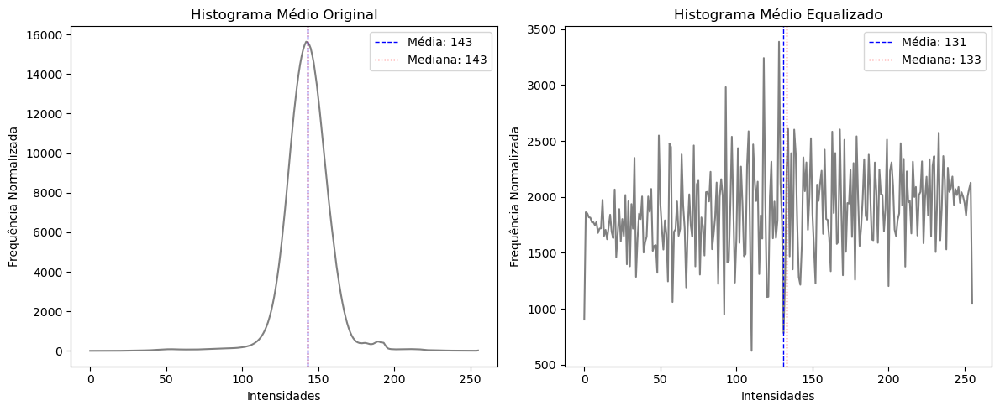

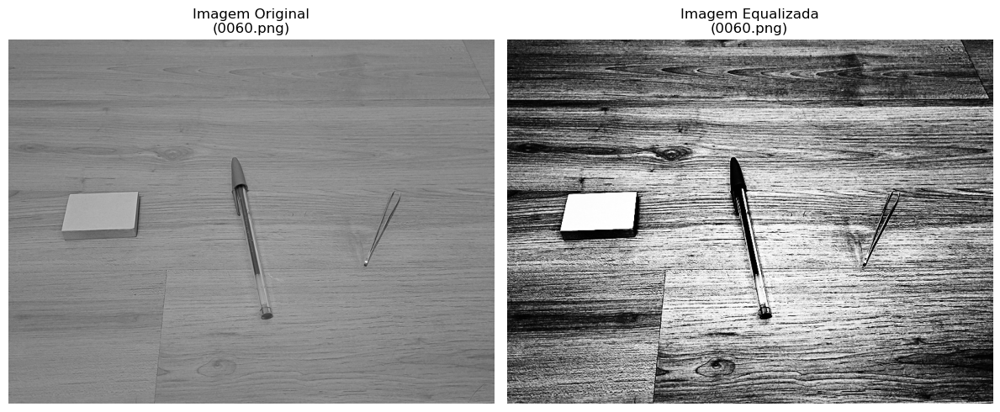

In [11]:
arquivos = metadados[(metadados['Grupo'] == 1) &
                     (metadados['Plano de Fundo'] == 'Madeira') &
                     (metadados['Luz'] == 'Amarela') &
                     (metadados['Ambiente'] == 'Interno')]['Nome Arquivo']
exemplo = np.random.choice(arquivos)
diretorio = ogdir

normaliza_e_mostra(arquivos, exemplo, diretorio)

### Parte 2.2: ```originalGrayDataset``` - Fundo: Concreto | Luz: Sombra | Ambiente: Externo (grupo 2)

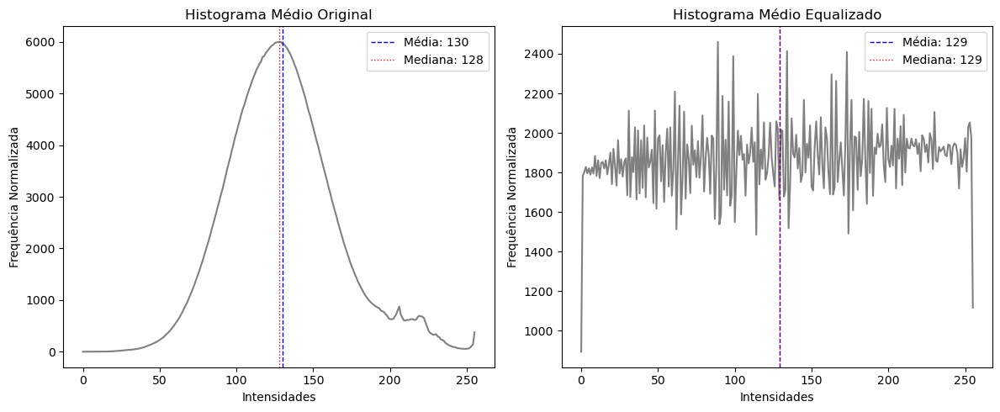

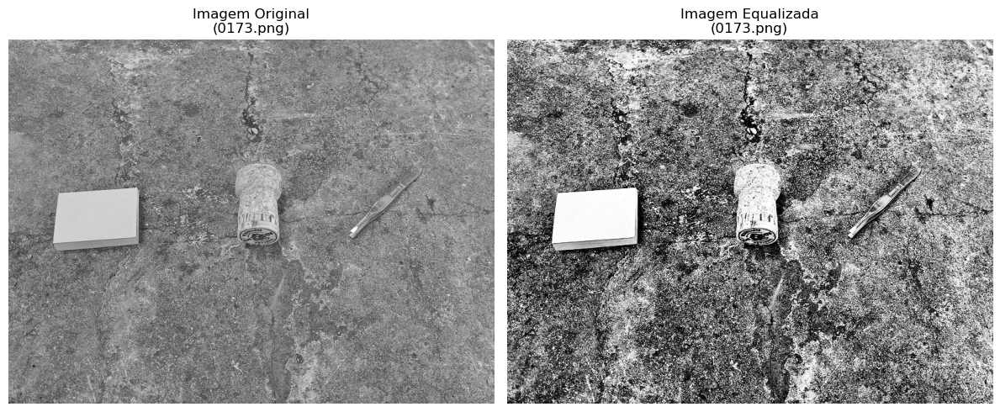

In [12]:
arquivos = metadados[(metadados['Grupo'] == 2) &
                     (metadados['Plano de Fundo'] == 'Concreto') &
                     (metadados['Luz'] == 'Sombra') &
                     (metadados['Ambiente'] == 'Externo')]['Nome Arquivo']
exemplo = np.random.choice(arquivos)
diretorio = ogdir

normaliza_e_mostra(arquivos, exemplo, diretorio)

### Parte 2.3: ```originalGrayDataset``` - Fundo: Branco | Luz: Branca | Ambiente: Interno (grupo 3)

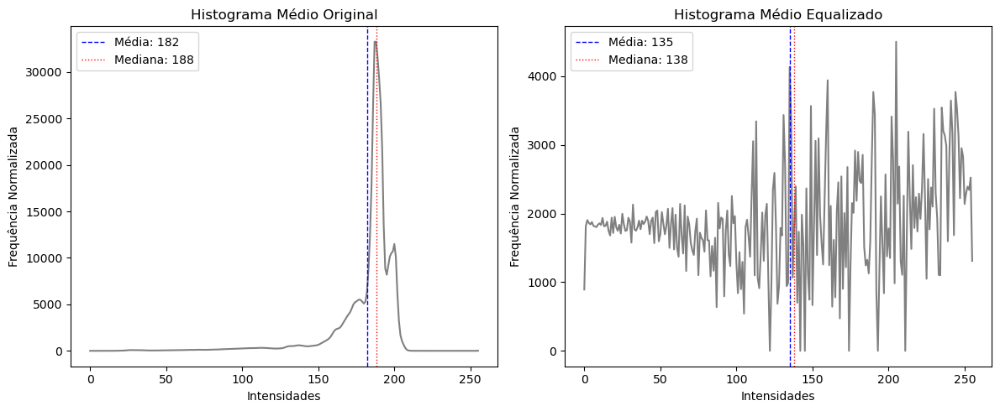

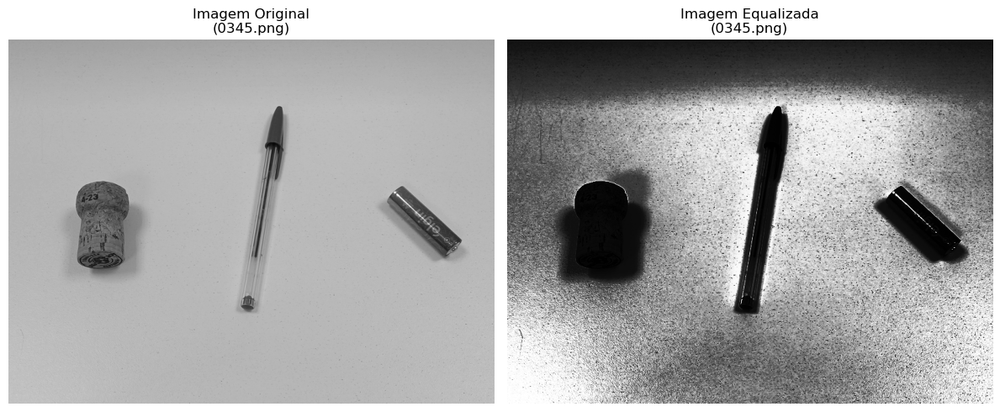

In [13]:
arquivos = metadados[(metadados['Grupo'] == 3) &
                     (metadados['Plano de Fundo'] == 'Branco') &
                     (metadados['Luz'] == 'Branca') &
                     (metadados['Ambiente'] == 'Interno')]['Nome Arquivo']
exemplo = np.random.choice(arquivos)
diretorio = ogdir

normaliza_e_mostra(arquivos, exemplo, diretorio)

### Parte 2.4: ```originalGrayDataset``` - Fundo: Cimento | Luz: Indireta | Ambiente: Interno (grupo 4)

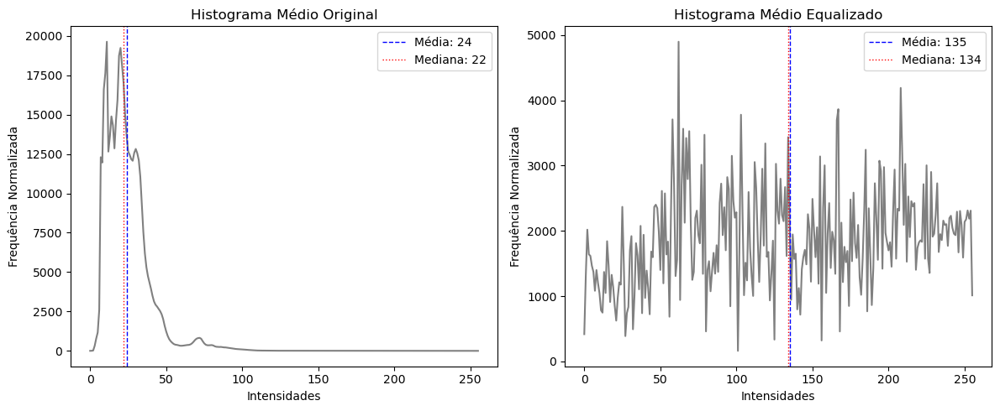

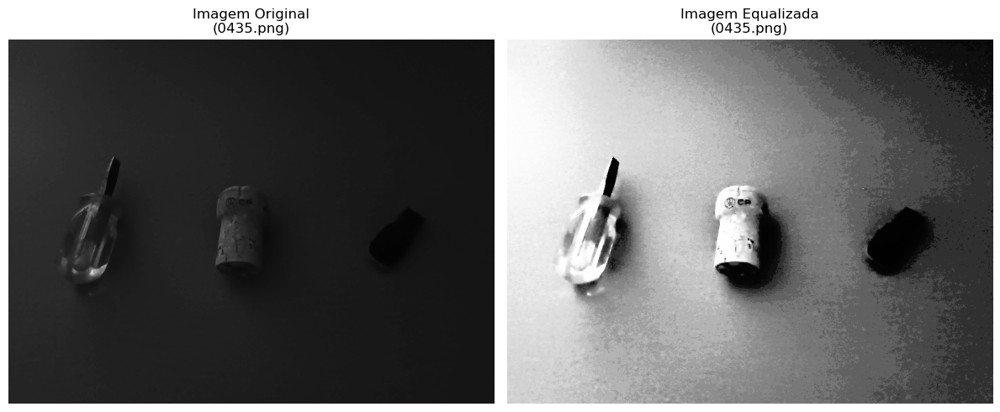

In [14]:
arquivos = metadados[(metadados['Grupo'] == 4) &
                     (metadados['Plano de Fundo'] == 'Cimento') &
                     (metadados['Luz'] == 'Indireta') &
                     (metadados['Ambiente'] == 'Interno')]['Nome Arquivo']
exemplo = np.random.choice(arquivos)
diretorio = ogdir

normaliza_e_mostra(arquivos, exemplo, diretorio)

### Parte 2.5: ```originalGrayDataset``` - Fundo: Pedra | Luz: Sol | Ambiente: Externo (grupo 5)

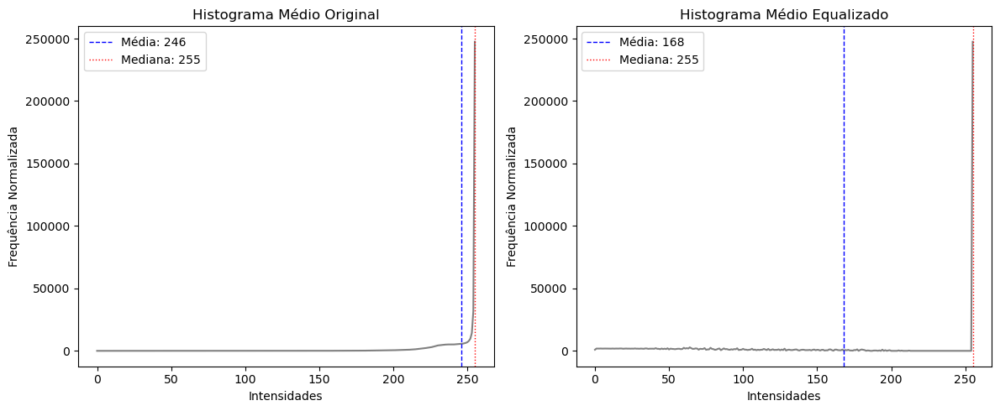

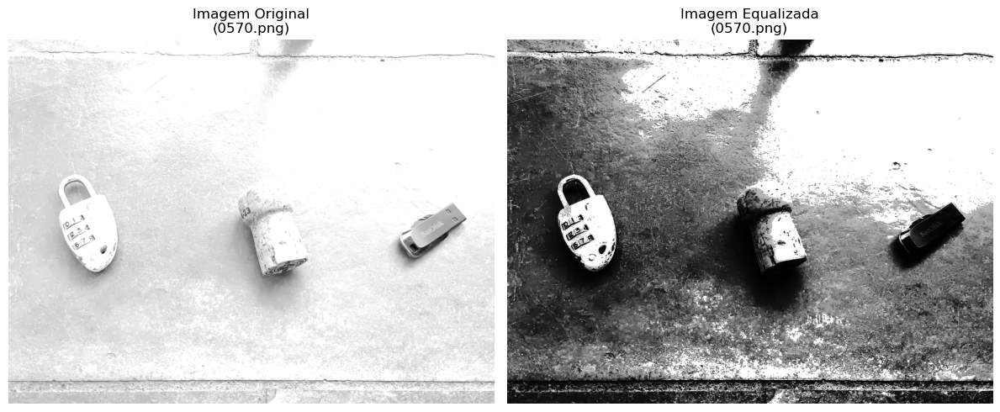

In [15]:
arquivos = metadados[(metadados['Grupo'] == 5) &
                     (metadados['Plano de Fundo'] == 'Pedra') &
                     (metadados['Luz'] == 'Sol') &
                     (metadados['Ambiente'] == 'Externo')]['Nome Arquivo']
exemplo = np.random.choice(arquivos)
diretorio = ogdir

normaliza_e_mostra(arquivos, exemplo, diretorio)

<hr style="border: 0; border-top: 1px solid black; width: 85%; margin: 0 auto;">

### Parte 2.6 : ```augmentedGrayDataset```- Transformação: Contrast Stretching

#### Parte 2.6.1: Fundo: Madeira | Luz: Amarela | Ambiente: Interno (grupo 1)

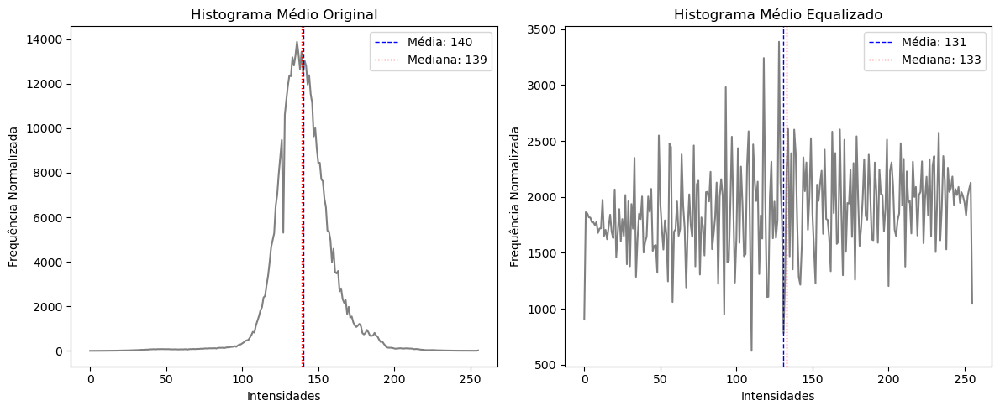

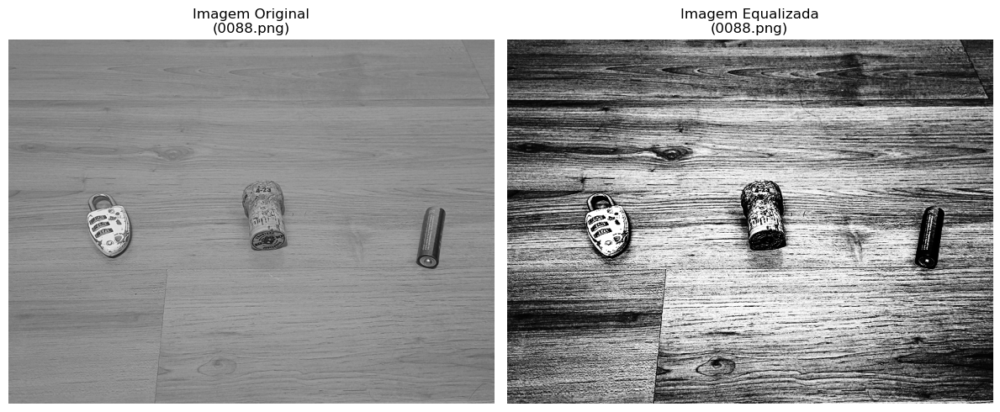

In [16]:
arquivos = metadados[(metadados['Grupo'] == 1) &
                     (metadados['Plano de Fundo'] == 'Madeira') &
                     (metadados['Luz'] == 'Amarela') &
                     (metadados['Ambiente'] == 'Interno')]['Nome Arquivo']
exemplo = np.random.choice(arquivos)
diretorio = agdir + '\\' + subdirs[0]

normaliza_e_mostra(arquivos, exemplo, diretorio)

#### Parte 2.6.2: Fundo: Concreto | Luz: Sombra | Ambiente: Externo (grupo 2)

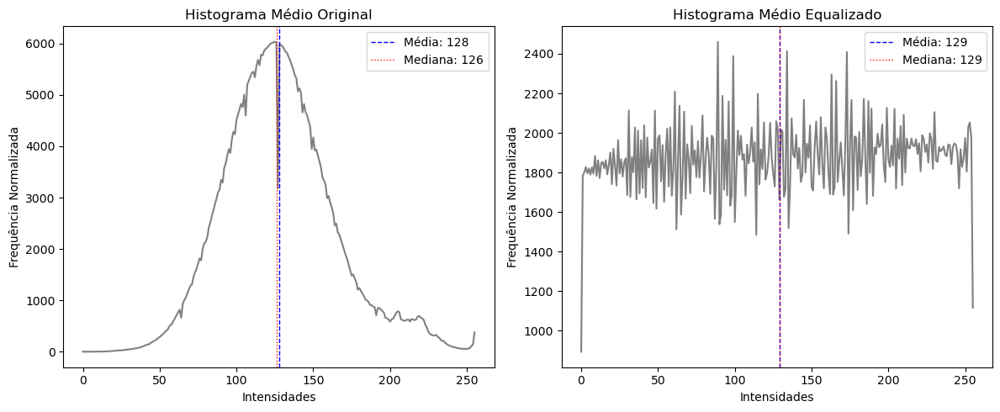

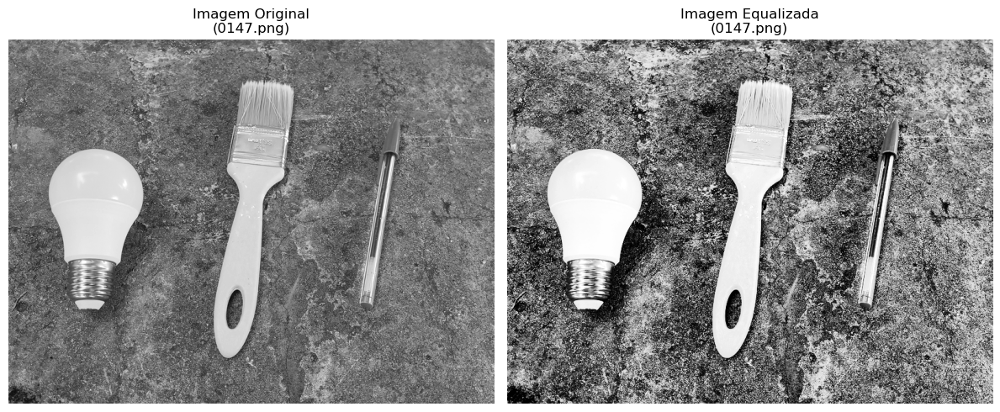

In [17]:
arquivos = metadados[(metadados['Grupo'] == 2) &
                     (metadados['Plano de Fundo'] == 'Concreto') &
                     (metadados['Luz'] == 'Sombra') &
                     (metadados['Ambiente'] == 'Externo')]['Nome Arquivo']
exemplo = np.random.choice(arquivos)
diretorio = agdir + '\\' + subdirs[0]

normaliza_e_mostra(arquivos, exemplo, diretorio)

#### Parte 2.6.3: Fundo: Fundo: Branco | Luz: Branca | Ambiente: Interno (grupo 3)

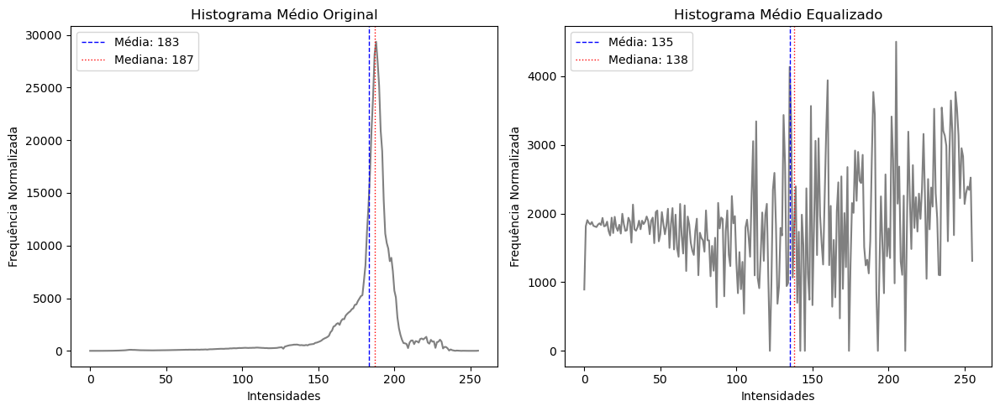

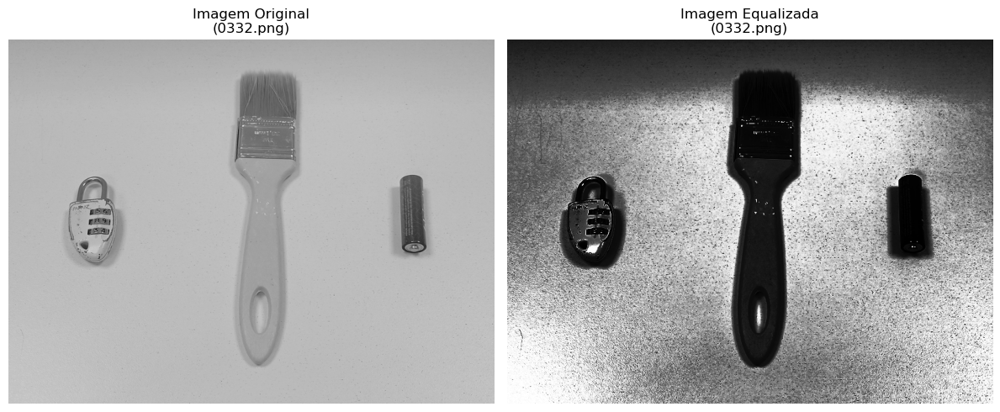

In [18]:
arquivos = metadados[(metadados['Grupo'] == 3) &
                     (metadados['Plano de Fundo'] == 'Branco') &
                     (metadados['Luz'] == 'Branca') &
                     (metadados['Ambiente'] == 'Interno')]['Nome Arquivo']
exemplo = np.random.choice(arquivos)
diretorio = agdir + '\\' + subdirs[0]

normaliza_e_mostra(arquivos, exemplo, diretorio)

#### Parte 2.6.4: Fundo: Cimento | Luz: Indireta | Ambiente: Interno (grupo 4)

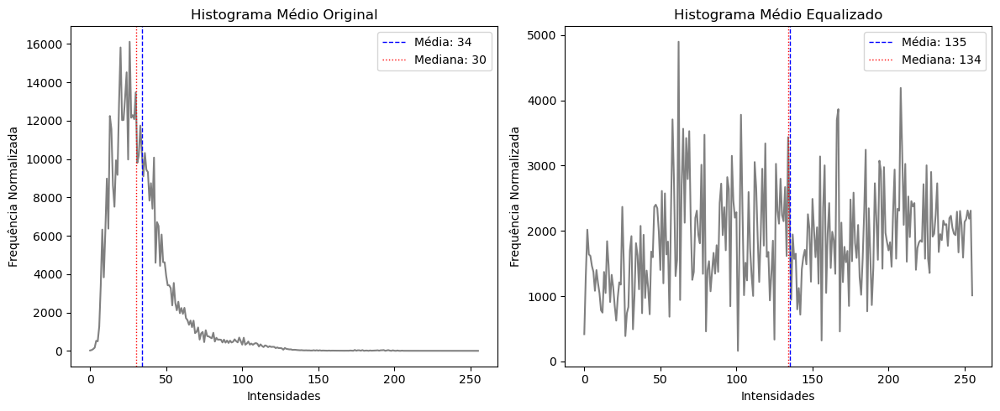

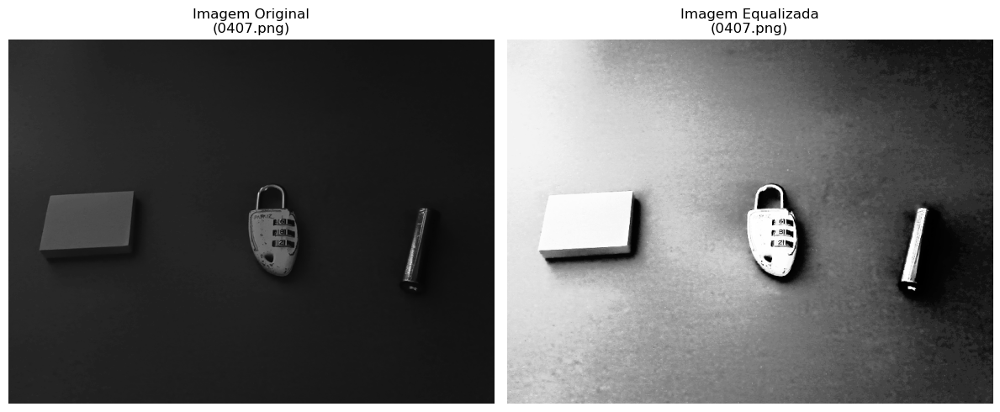

In [19]:
arquivos = metadados[(metadados['Grupo'] == 4) &
                     (metadados['Plano de Fundo'] == 'Cimento') &
                     (metadados['Luz'] == 'Indireta') &
                     (metadados['Ambiente'] == 'Interno')]['Nome Arquivo']
exemplo = np.random.choice(arquivos)
diretorio = agdir + '\\' + subdirs[0]

normaliza_e_mostra(arquivos, exemplo, diretorio)

#### Parte 2.6.5: Fundo: Pedra | Luz: Sol | Ambiente: Externo (grupo 5)

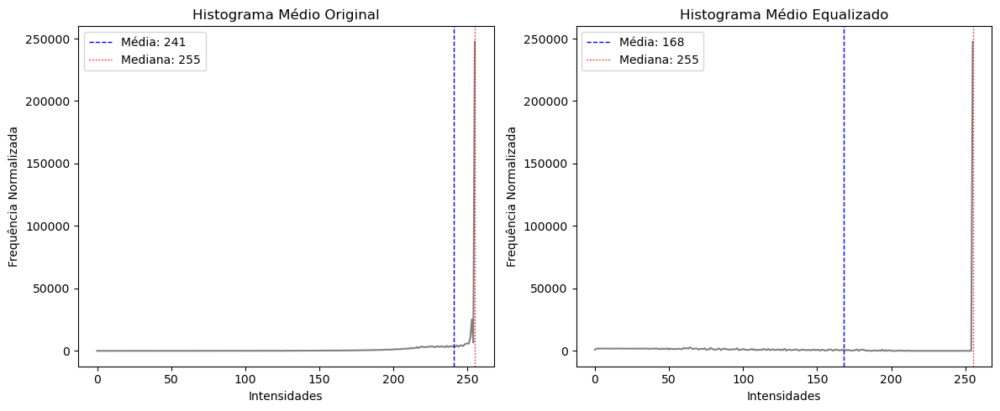

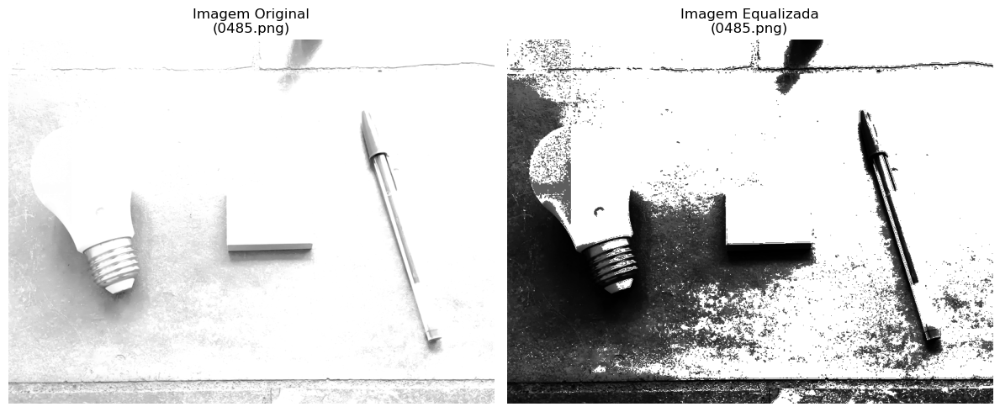

In [20]:
arquivos = metadados[(metadados['Grupo'] == 5) &
                     (metadados['Plano de Fundo'] == 'Pedra') &
                     (metadados['Luz'] == 'Sol') &
                     (metadados['Ambiente'] == 'Externo')]['Nome Arquivo']
exemplo = np.random.choice(arquivos)
diretorio = agdir + '\\' + subdirs[0]

normaliza_e_mostra(arquivos, exemplo, diretorio)

<hr style="border: 0; border-top: 1px solid black; width: 85%; margin: 0 auto;">

### Parte 2.7 : ```augmentedGrayDataset```- Transformação: Logarítmo

#### Parte 2.7.1: Fundo: Madeira | Luz: Amarela | Ambiente: Interno (grupo 1)

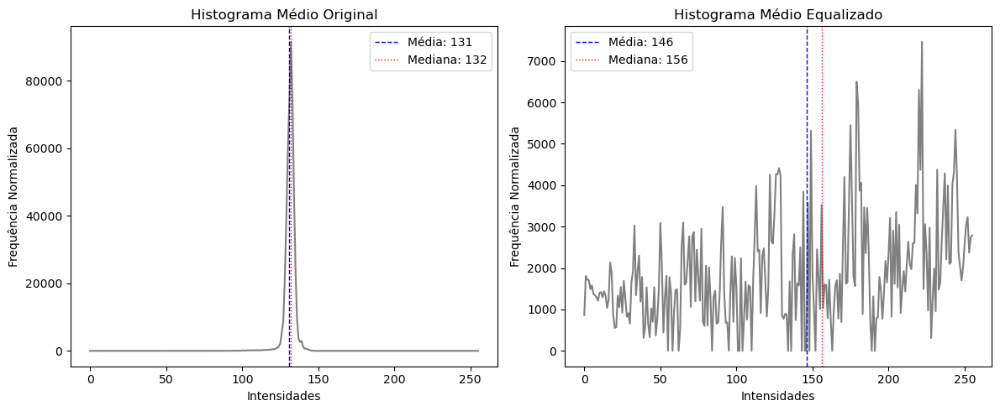

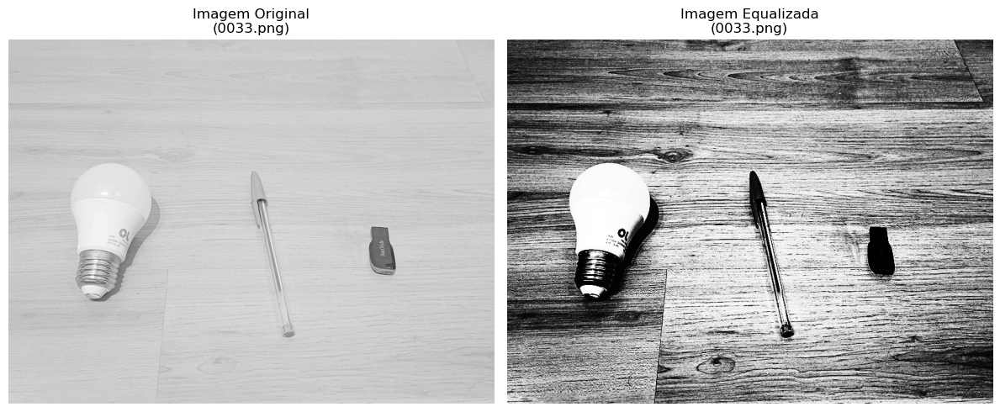

In [21]:
arquivos = metadados[(metadados['Grupo'] == 1) &
                     (metadados['Plano de Fundo'] == 'Madeira') &
                     (metadados['Luz'] == 'Amarela') &
                     (metadados['Ambiente'] == 'Interno')]['Nome Arquivo']
exemplo = np.random.choice(arquivos)
diretorio = agdir + '\\' + subdirs[1]

normaliza_e_mostra(arquivos, exemplo, diretorio)

#### Parte 2.7.2: Fundo: Concreto | Luz: Sombra | Ambiente: Externo (grupo 2)

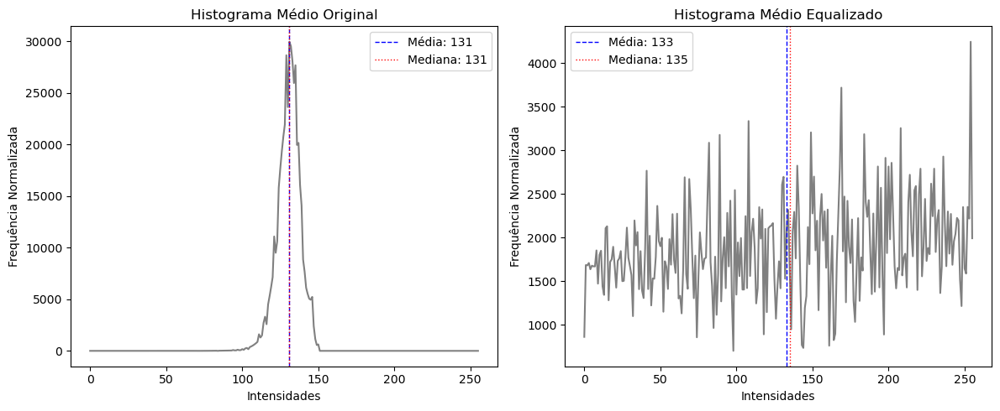

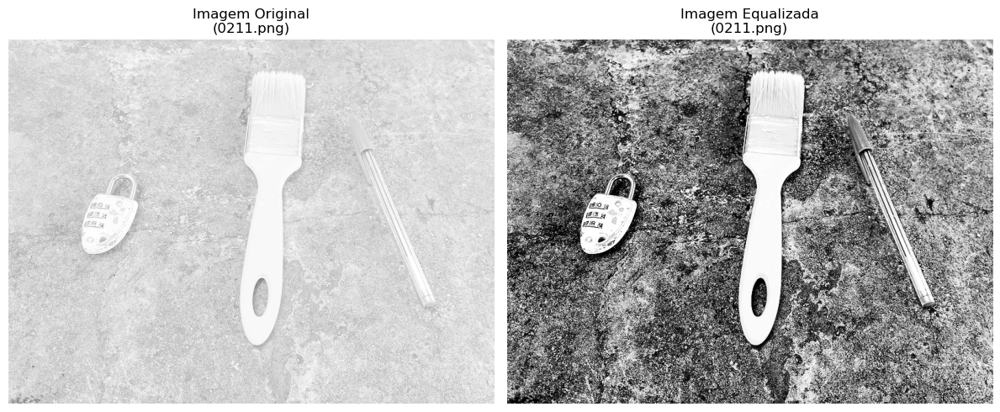

In [22]:
arquivos = metadados[(metadados['Grupo'] == 2) &
                     (metadados['Plano de Fundo'] == 'Concreto') &
                     (metadados['Luz'] == 'Sombra') &
                     (metadados['Ambiente'] == 'Externo')]['Nome Arquivo']
exemplo = np.random.choice(arquivos)
diretorio = agdir + '\\' + subdirs[1]

normaliza_e_mostra(arquivos, exemplo, diretorio)

#### Parte 2.7.3: Fundo: Fundo: Branco | Luz: Branca | Ambiente: Interno (grupo 3)

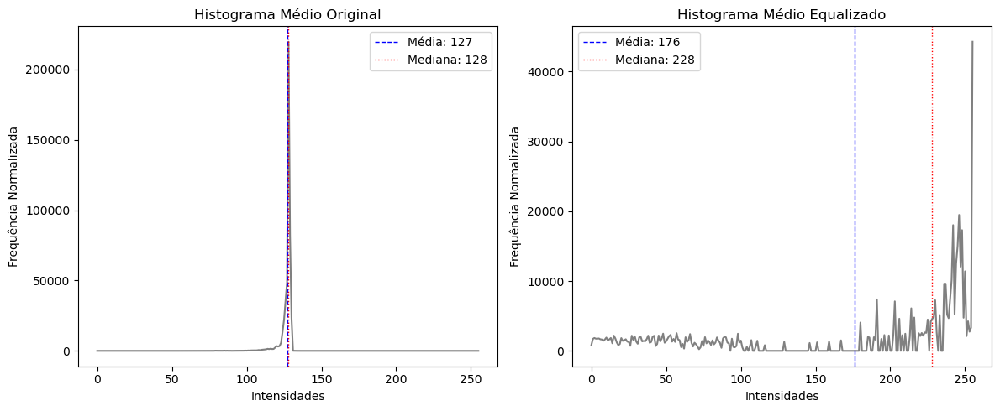

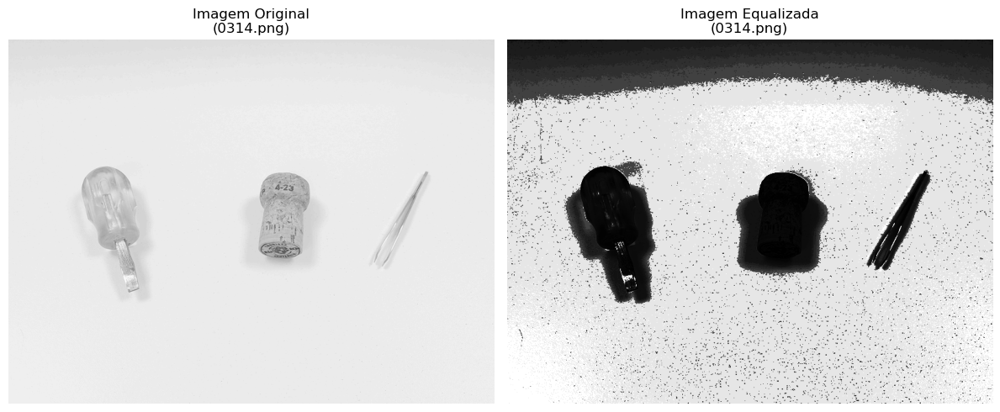

In [23]:
arquivos = metadados[(metadados['Grupo'] == 3) &
                     (metadados['Plano de Fundo'] == 'Branco') &
                     (metadados['Luz'] == 'Branca') &
                     (metadados['Ambiente'] == 'Interno')]['Nome Arquivo']
exemplo = np.random.choice(arquivos)
diretorio = agdir + '\\' + subdirs[1]

normaliza_e_mostra(arquivos, exemplo, diretorio)

#### Parte 2.7.4: Fundo: Cimento | Luz: Indireta | Ambiente: Interno (grupo 4)

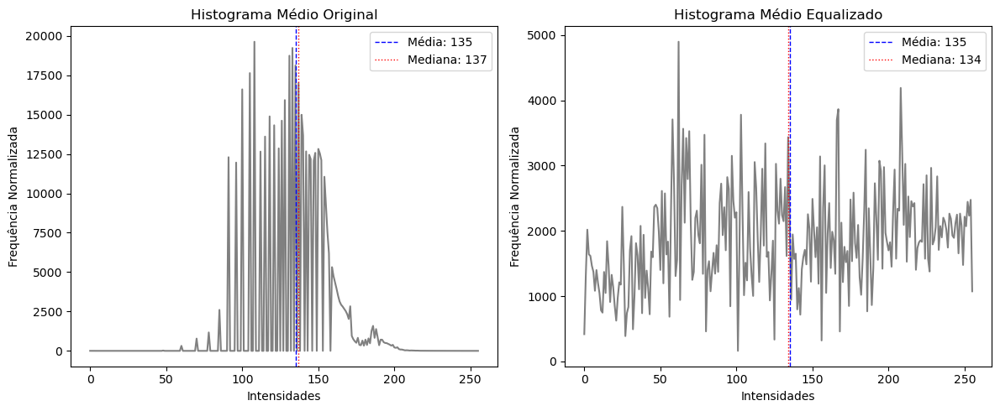

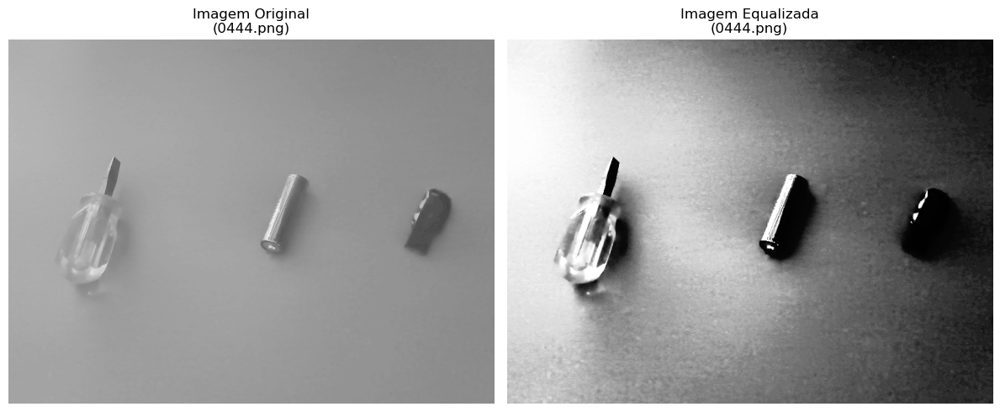

In [24]:
arquivos = metadados[(metadados['Grupo'] == 4) &
                     (metadados['Plano de Fundo'] == 'Cimento') &
                     (metadados['Luz'] == 'Indireta') &
                     (metadados['Ambiente'] == 'Interno')]['Nome Arquivo']
exemplo = np.random.choice(arquivos)
diretorio = agdir + '\\' + subdirs[1]

normaliza_e_mostra(arquivos, exemplo, diretorio)

#### Parte 2.7.5: Fundo: Pedra | Luz: Sol | Ambiente: Externo (grupo 5)

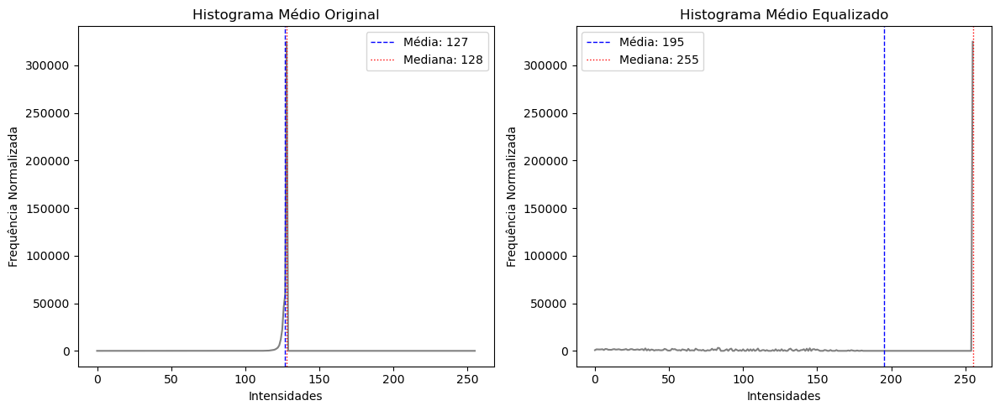

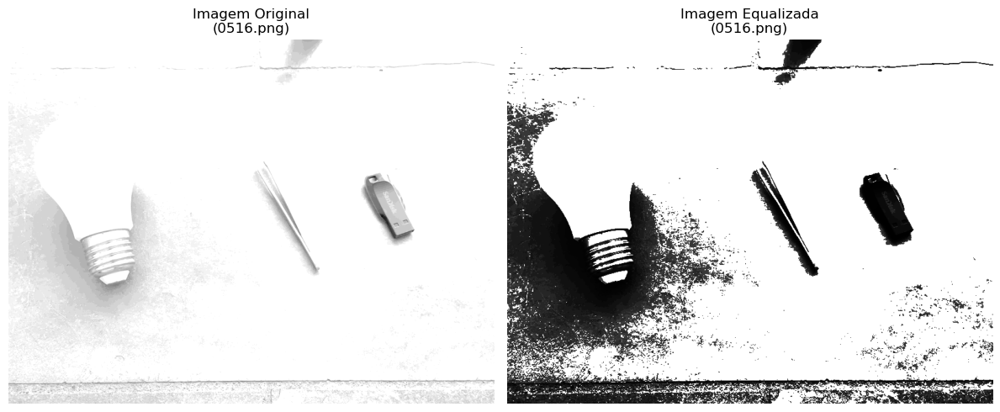

In [25]:
arquivos = metadados[(metadados['Grupo'] == 5) &
                     (metadados['Plano de Fundo'] == 'Pedra') &
                     (metadados['Luz'] == 'Sol') &
                     (metadados['Ambiente'] == 'Externo')]['Nome Arquivo']
exemplo = np.random.choice(arquivos)
diretorio = agdir + '\\' + subdirs[1]

normaliza_e_mostra(arquivos, exemplo, diretorio)

<hr style="border: 0; border-top: 1px solid black; width: 85%; margin: 0 auto;">

### Parte 2.8: ```augmentedGrayDataset```- Transformação: Exponencial

#### Parte 2.8.1: Fundo: Madeira | Luz: Amarela | Ambiente: Interno (grupo 1)

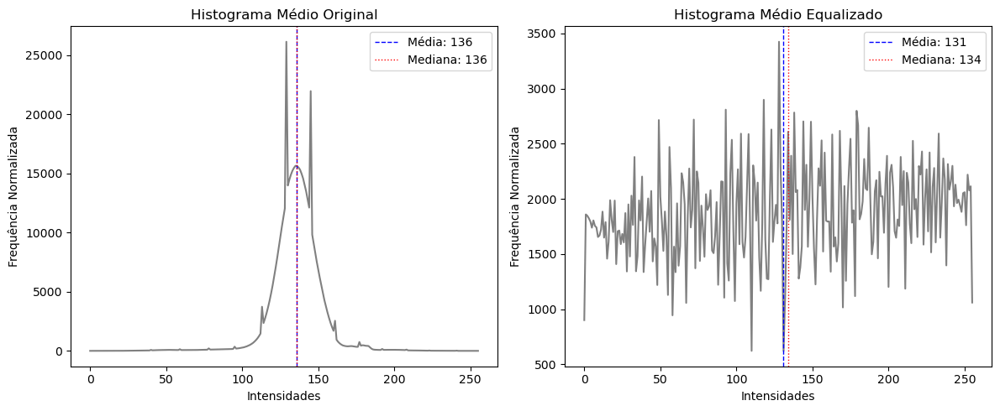

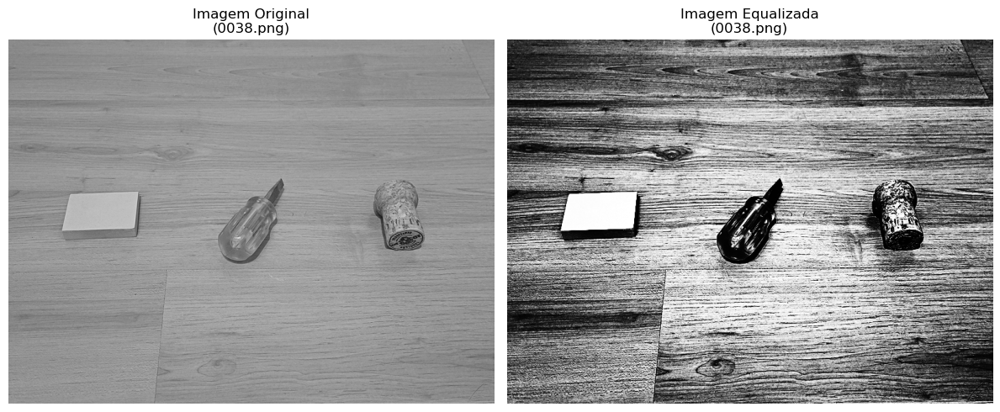

In [26]:
arquivos = metadados[(metadados['Grupo'] == 1) &
                     (metadados['Plano de Fundo'] == 'Madeira') &
                     (metadados['Luz'] == 'Amarela') &
                     (metadados['Ambiente'] == 'Interno')]['Nome Arquivo']
exemplo = np.random.choice(arquivos)
diretorio = agdir + '\\' + subdirs[2]

normaliza_e_mostra(arquivos, exemplo, diretorio)

#### Parte 2.8.2: Fundo: Concreto | Luz: Sombra | Ambiente: Externo (grupo 2)

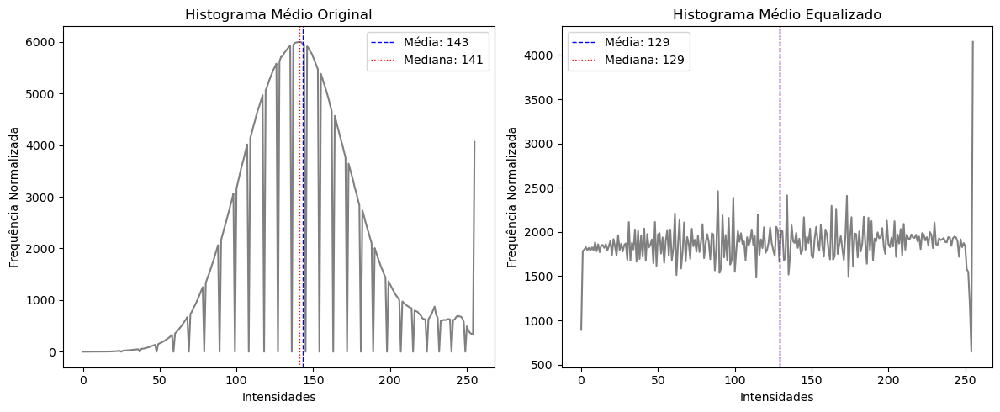

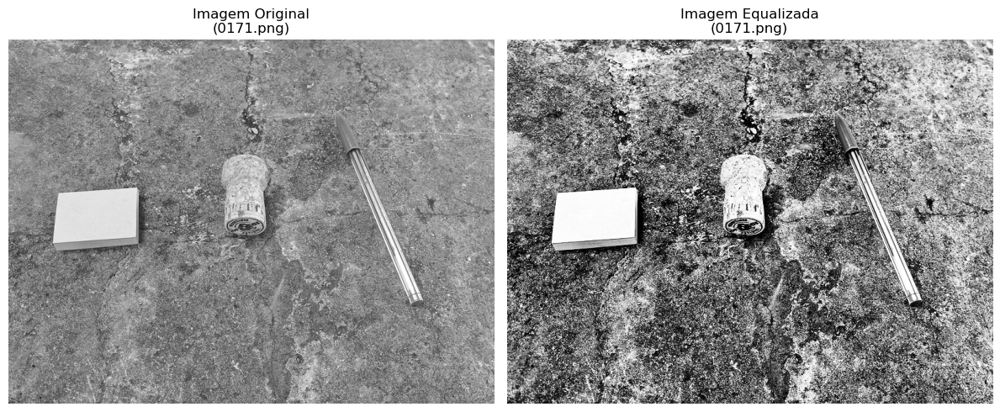

In [27]:
arquivos = metadados[(metadados['Grupo'] == 2) &
                     (metadados['Plano de Fundo'] == 'Concreto') &
                     (metadados['Luz'] == 'Sombra') &
                     (metadados['Ambiente'] == 'Externo')]['Nome Arquivo']
exemplo = np.random.choice(arquivos)
diretorio = agdir + '\\' + subdirs[2]

normaliza_e_mostra(arquivos, exemplo, diretorio)

#### Parte 2.8.3: Fundo: Fundo: Branco | Luz: Branca | Ambiente: Interno (grupo 3)

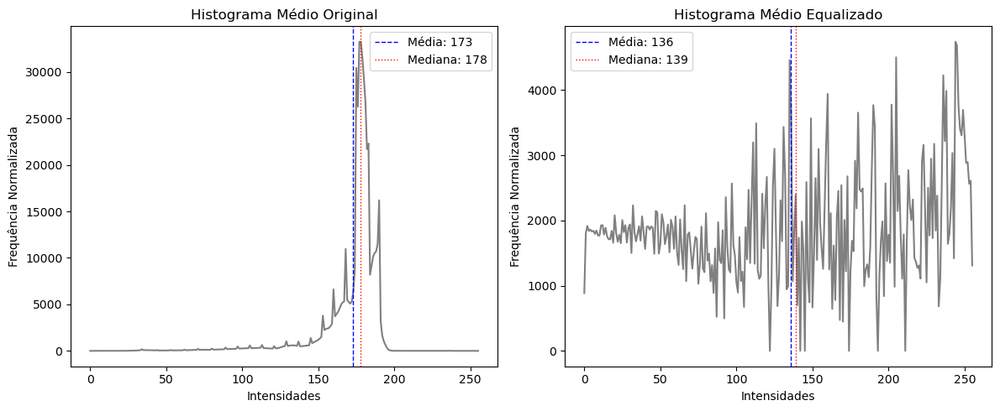

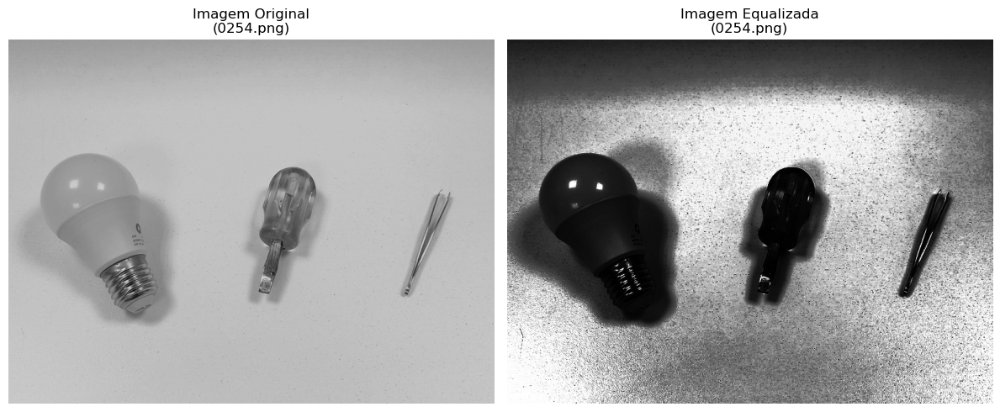

In [28]:
arquivos = metadados[(metadados['Grupo'] == 3) &
                     (metadados['Plano de Fundo'] == 'Branco') &
                     (metadados['Luz'] == 'Branca') &
                     (metadados['Ambiente'] == 'Interno')]['Nome Arquivo']
exemplo = np.random.choice(arquivos)
diretorio = agdir + '\\' + subdirs[2]

normaliza_e_mostra(arquivos, exemplo, diretorio)

#### Parte 2.8.4: Fundo: Cimento | Luz: Indireta | Ambiente: Interno (grupo 4)

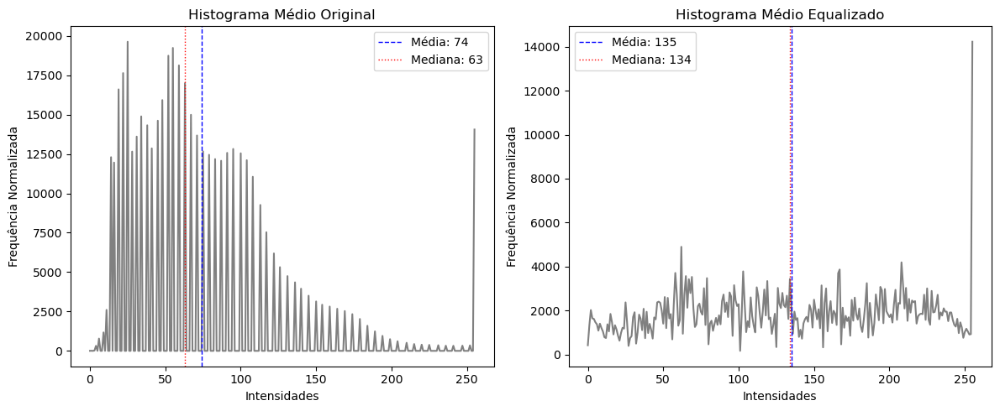

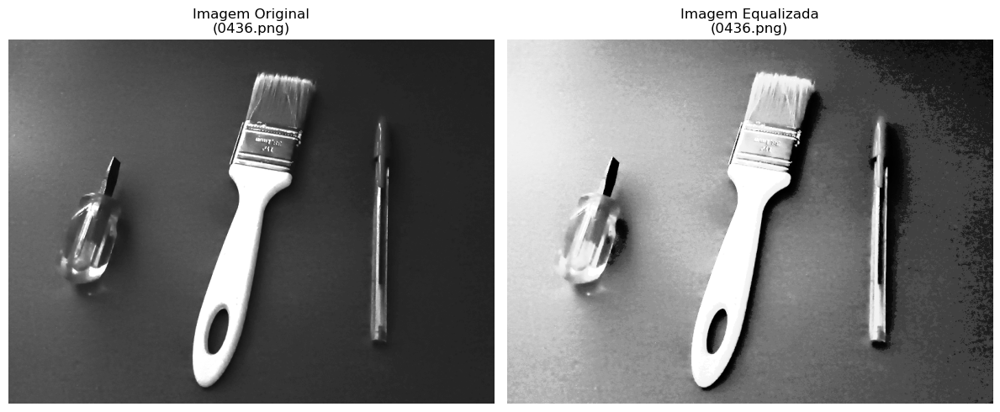

In [29]:
arquivos = metadados[(metadados['Grupo'] == 4) &
                     (metadados['Plano de Fundo'] == 'Cimento') &
                     (metadados['Luz'] == 'Indireta') &
                     (metadados['Ambiente'] == 'Interno')]['Nome Arquivo']
exemplo = np.random.choice(arquivos)
diretorio = agdir + '\\' + subdirs[2]

normaliza_e_mostra(arquivos, exemplo, diretorio)

#### Parte 2.8.5: Fundo: Pedra | Luz: Sol | Ambiente: Externo (grupo 5)

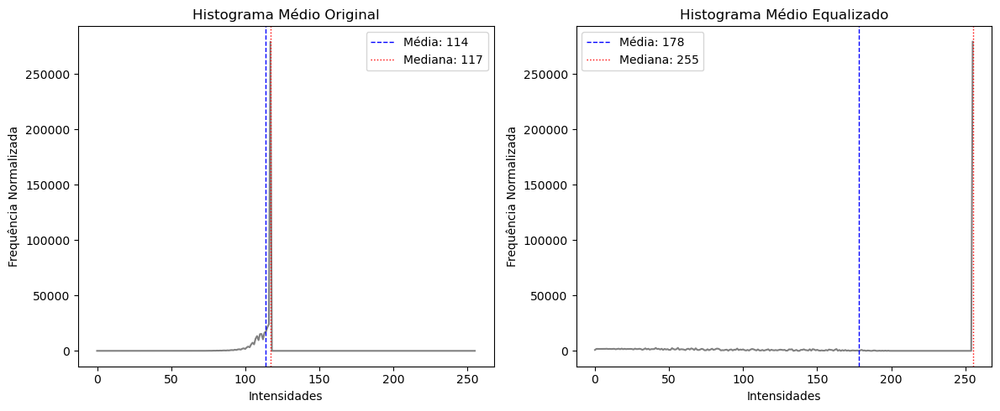

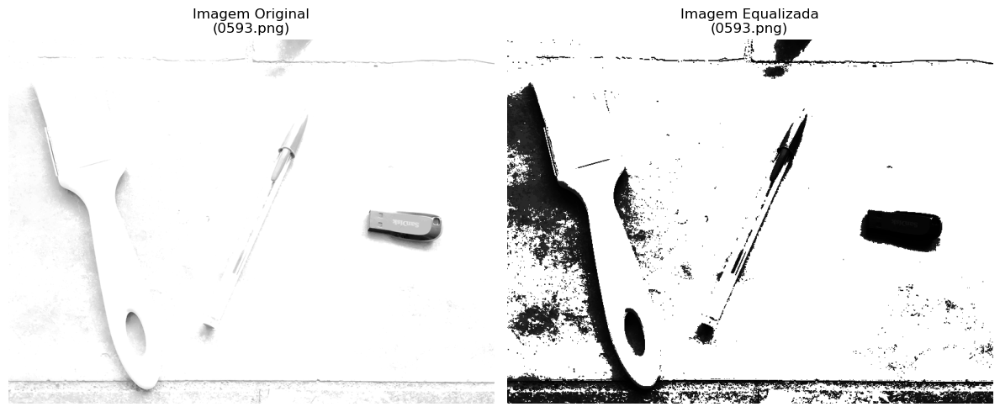

In [30]:
arquivos = metadados[(metadados['Grupo'] == 5) &
                     (metadados['Plano de Fundo'] == 'Pedra') &
                     (metadados['Luz'] == 'Sol') &
                     (metadados['Ambiente'] == 'Externo')]['Nome Arquivo']
exemplo = np.random.choice(arquivos)
diretorio = agdir + '\\' + subdirs[2]

normaliza_e_mostra(arquivos, exemplo, diretorio)

<hr style="border: 0; border-top: 1px solid black; width: 85%; margin: 0 auto;">

### Parte 2.9: ```augmentedGrayDataset``` - Transformação: Laplaciano

#### Parte 2.9.1: Fundo: Madeira | Luz: Amarela | Ambiente: Interno (grupo 1)

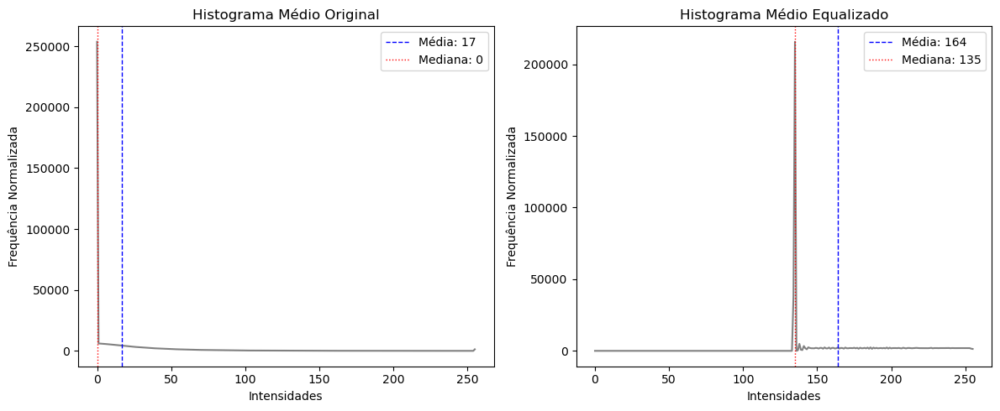

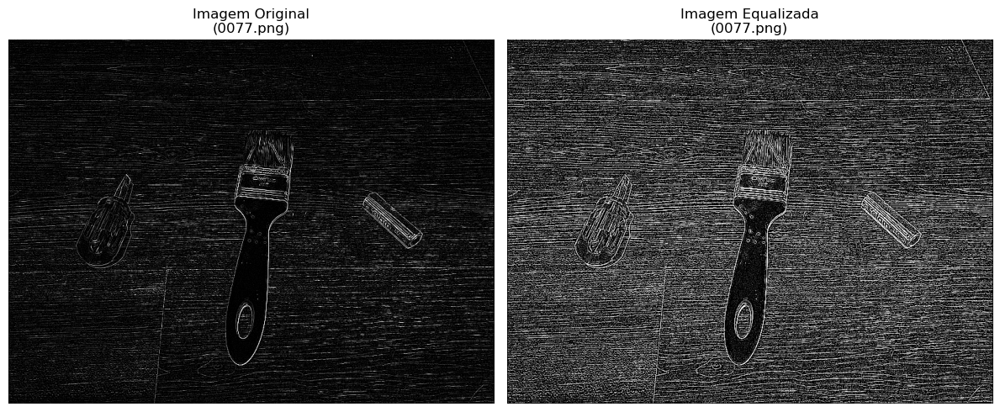

In [31]:
arquivos = metadados[(metadados['Grupo'] == 1) &
                     (metadados['Plano de Fundo'] == 'Madeira') &
                     (metadados['Luz'] == 'Amarela') &
                     (metadados['Ambiente'] == 'Interno')]['Nome Arquivo']
exemplo = np.random.choice(arquivos)
diretorio = agdir + '\\' + subdirs[3]

normaliza_e_mostra(arquivos, exemplo, diretorio)

#### Parte 2.9.2: Fundo: Concreto | Luz: Sombra | Ambiente: Externo (grupo 2)

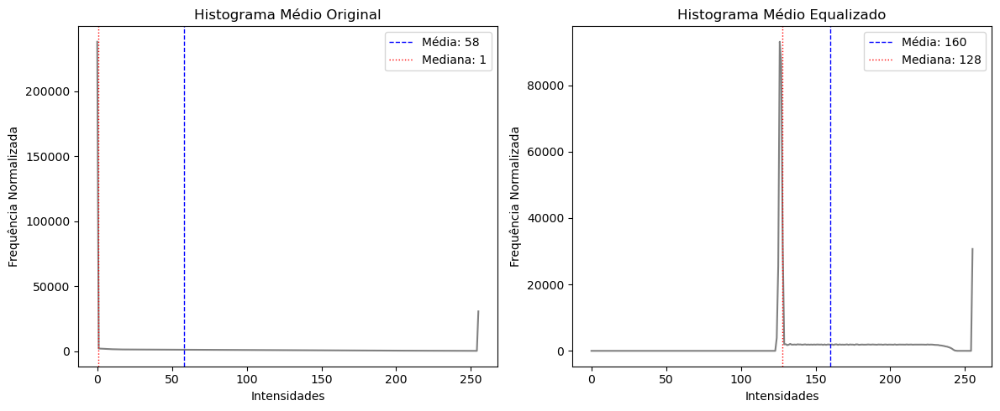

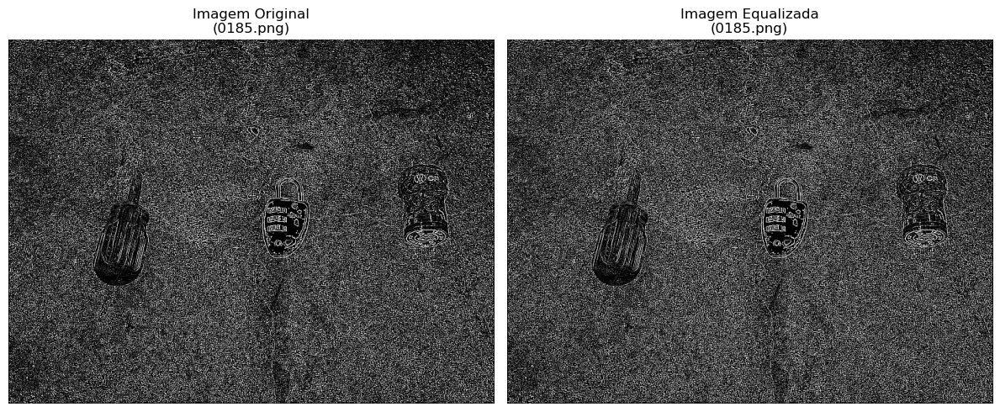

In [32]:
arquivos = metadados[(metadados['Grupo'] == 2) &
                     (metadados['Plano de Fundo'] == 'Concreto') &
                     (metadados['Luz'] == 'Sombra') &
                     (metadados['Ambiente'] == 'Externo')]['Nome Arquivo']
exemplo = np.random.choice(arquivos)
diretorio = agdir + '\\' + subdirs[3]

normaliza_e_mostra(arquivos, exemplo, diretorio)

#### Parte 2.9.3: Fundo: Fundo: Branco | Luz: Branca | Ambiente: Interno (grupo 3)

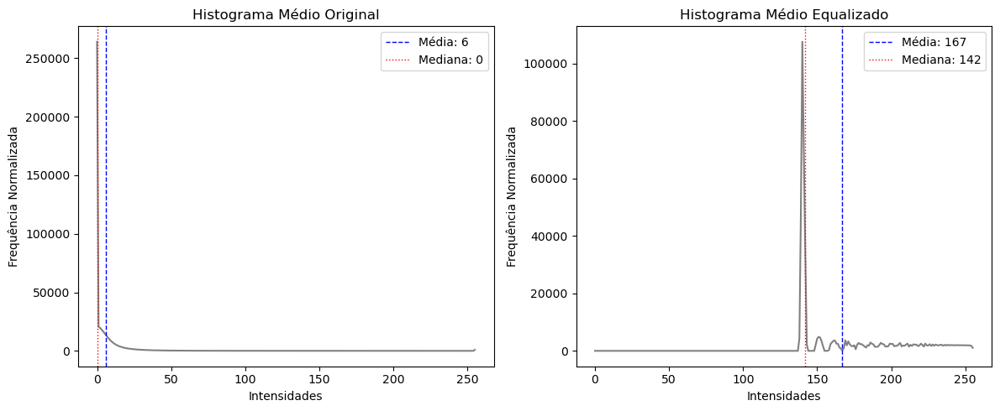

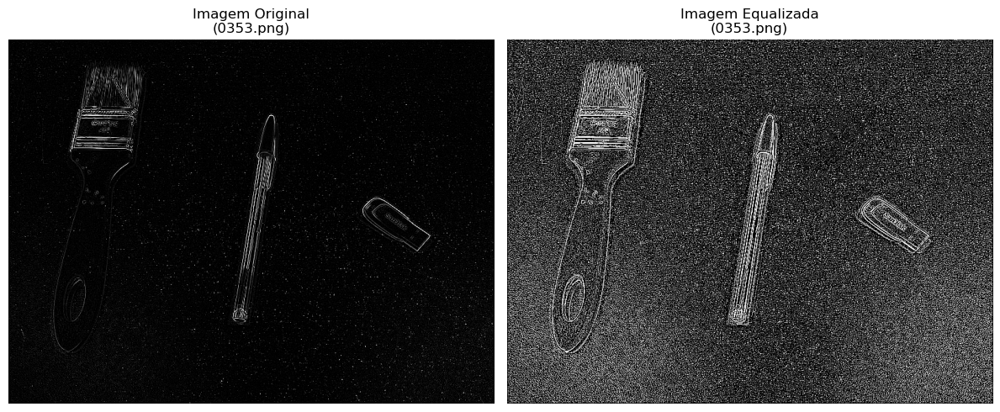

In [33]:
arquivos = metadados[(metadados['Grupo'] == 3) &
                     (metadados['Plano de Fundo'] == 'Branco') &
                     (metadados['Luz'] == 'Branca') &
                     (metadados['Ambiente'] == 'Interno')]['Nome Arquivo']
exemplo = np.random.choice(arquivos)
diretorio = agdir + '\\' + subdirs[3]

normaliza_e_mostra(arquivos, exemplo, diretorio)

#### Parte 2.9.4: Fundo: Cimento | Luz: Indireta | Ambiente: Interno (grupo 4)

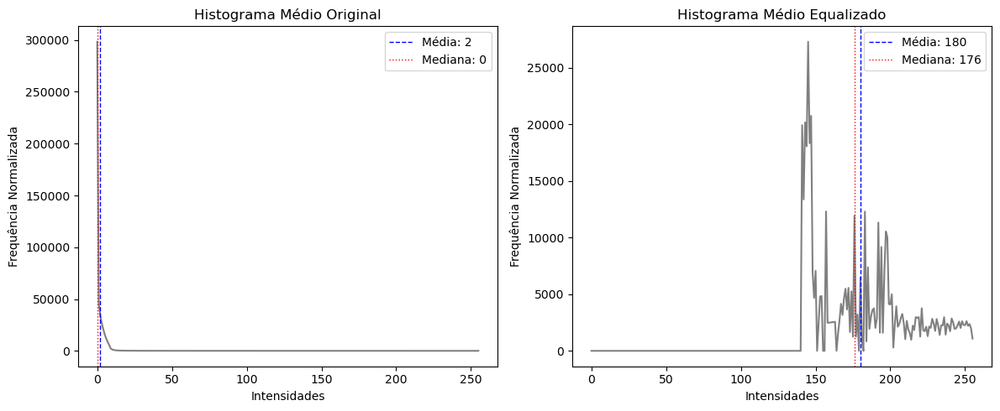

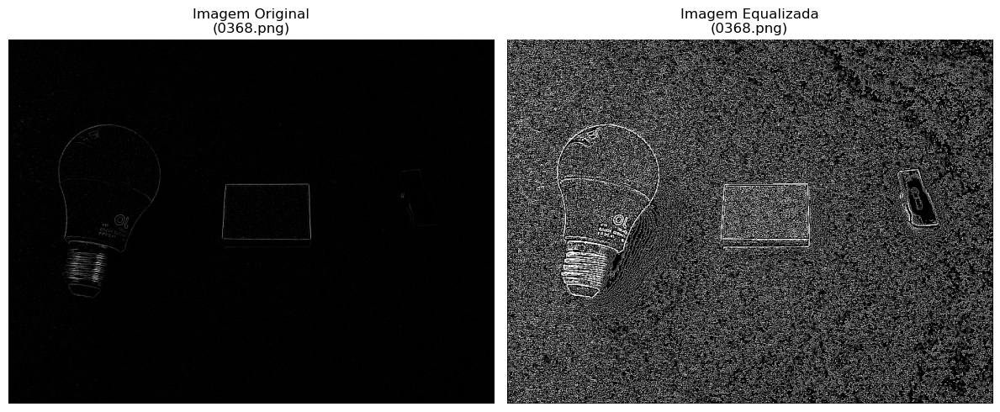

In [34]:
arquivos = metadados[(metadados['Grupo'] == 4) &
                     (metadados['Plano de Fundo'] == 'Cimento') &
                     (metadados['Luz'] == 'Indireta') &
                     (metadados['Ambiente'] == 'Interno')]['Nome Arquivo']
exemplo = np.random.choice(arquivos)
diretorio = agdir + '\\' + subdirs[3]

normaliza_e_mostra(arquivos, exemplo, diretorio)

#### Parte 2.9.5: Fundo: Pedra | Luz: Sol | Ambiente: Externo (grupo 5)

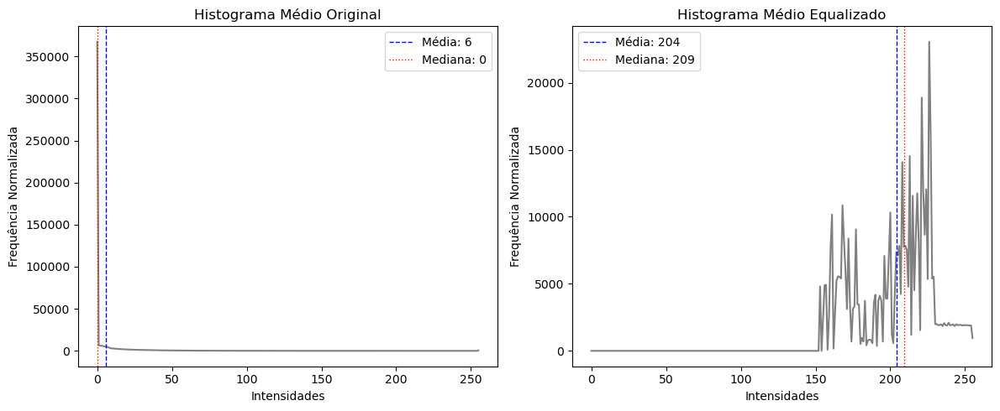

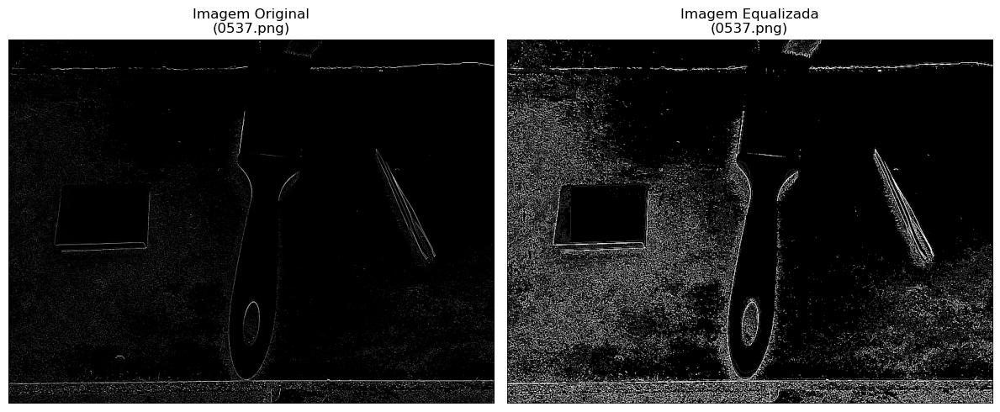

In [35]:
arquivos = metadados[(metadados['Grupo'] == 5) &
                     (metadados['Plano de Fundo'] == 'Pedra') &
                     (metadados['Luz'] == 'Sol') &
                     (metadados['Ambiente'] == 'Externo')]['Nome Arquivo']
exemplo = np.random.choice(arquivos)
diretorio = agdir + '\\' + subdirs[3]

normaliza_e_mostra(arquivos, exemplo, diretorio)

<hr style="border: 0; border-top: 1px solid black; width: 85%; margin: 0 auto;">

### Parte 2.10: ```augmentedGrayDataset``` - Transformação: Suavização/Média

#### Parte 2.10.1: Fundo: Madeira | Luz: Amarela | Ambiente: Interno (grupo 1)

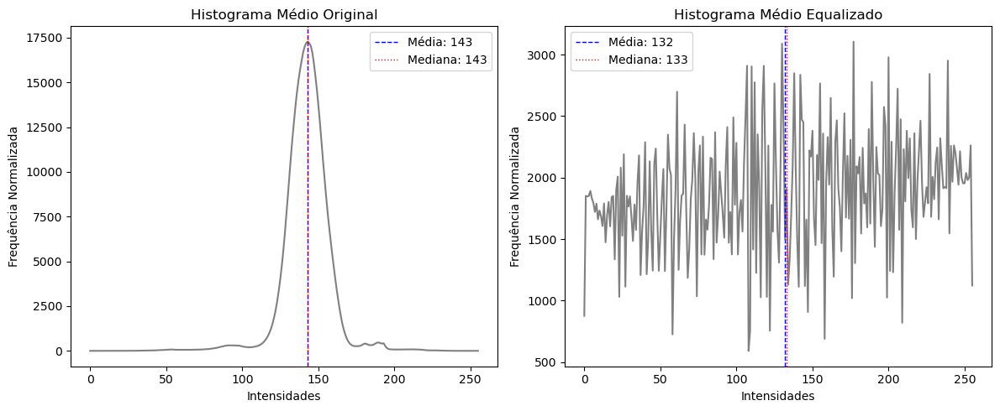

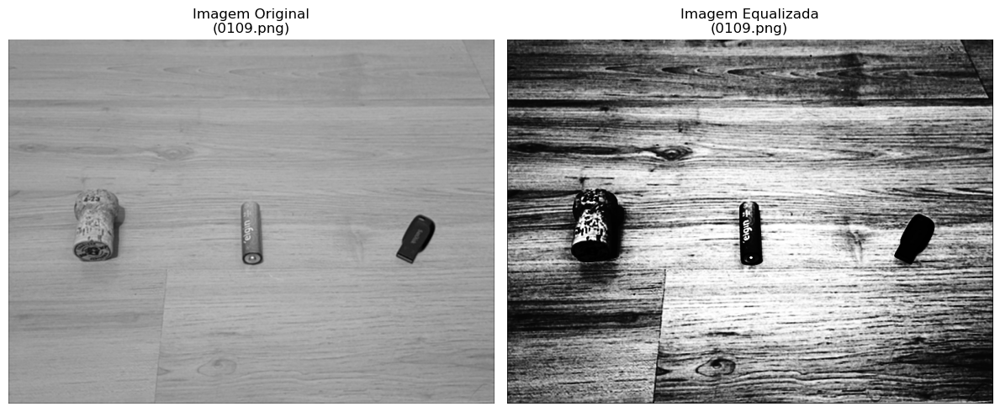

In [36]:
arquivos = metadados[(metadados['Grupo'] == 1) &
                     (metadados['Plano de Fundo'] == 'Madeira') &
                     (metadados['Luz'] == 'Amarela') &
                     (metadados['Ambiente'] == 'Interno')]['Nome Arquivo']
exemplo = np.random.choice(arquivos)
diretorio = agdir + '\\' + subdirs[4]

normaliza_e_mostra(arquivos, exemplo, diretorio)

#### Parte 2.10.2: Fundo: Concreto | Luz: Sombra | Ambiente: Externo (grupo 2)

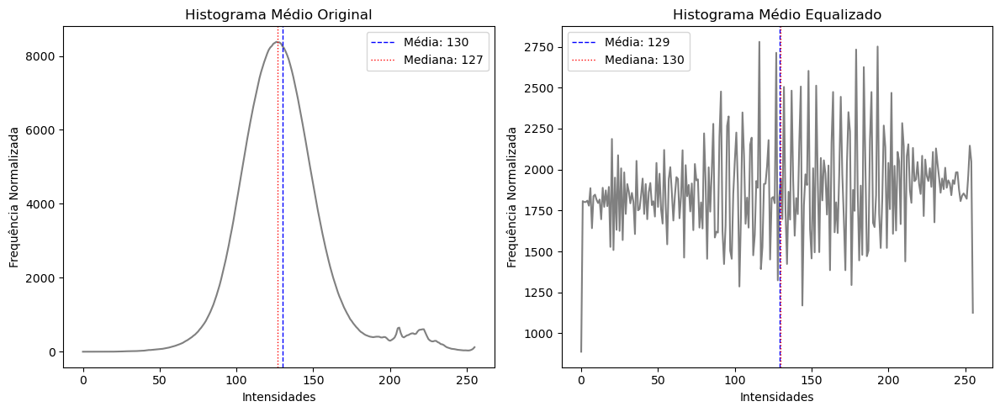

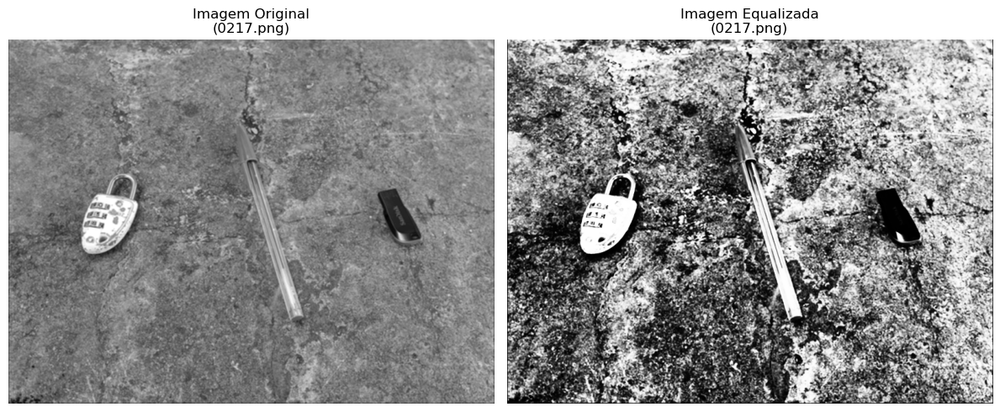

In [37]:
arquivos = metadados[(metadados['Grupo'] == 2) &
                     (metadados['Plano de Fundo'] == 'Concreto') &
                     (metadados['Luz'] == 'Sombra') &
                     (metadados['Ambiente'] == 'Externo')]['Nome Arquivo']
exemplo = np.random.choice(arquivos)
diretorio = agdir + '\\' + subdirs[4]

normaliza_e_mostra(arquivos, exemplo, diretorio)

#### Parte 2.10.3: Fundo: Fundo: Branco | Luz: Branca | Ambiente: Interno (grupo 3)

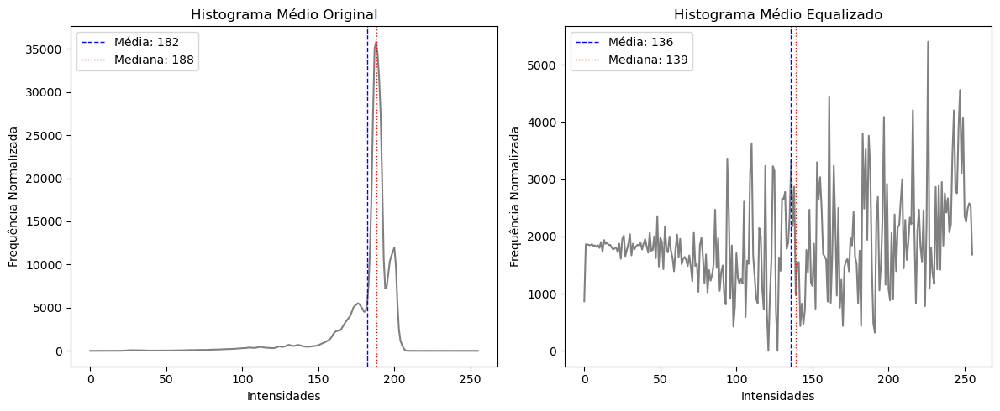

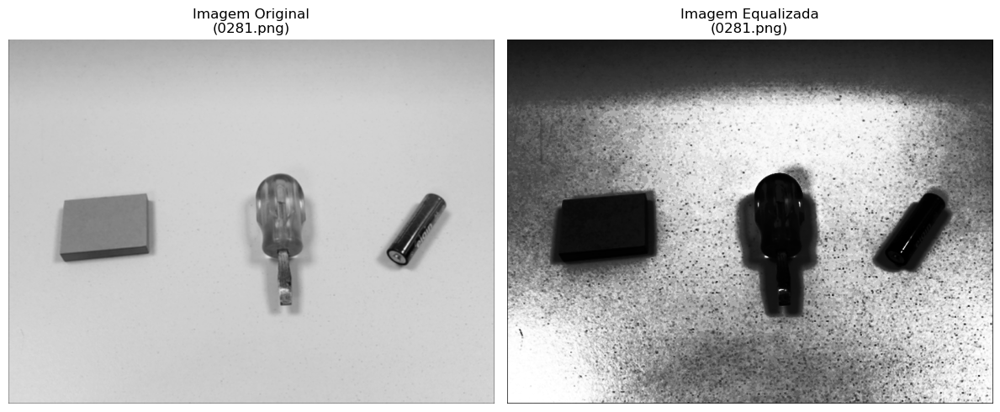

In [38]:
arquivos = metadados[(metadados['Grupo'] == 3) &
                     (metadados['Plano de Fundo'] == 'Branco') &
                     (metadados['Luz'] == 'Branca') &
                     (metadados['Ambiente'] == 'Interno')]['Nome Arquivo']
exemplo = np.random.choice(arquivos)
diretorio = agdir + '\\' + subdirs[4]

normaliza_e_mostra(arquivos, exemplo, diretorio)

#### Parte 2.10.4: Fundo: Cimento | Luz: Indireta | Ambiente: Interno (grupo 4)

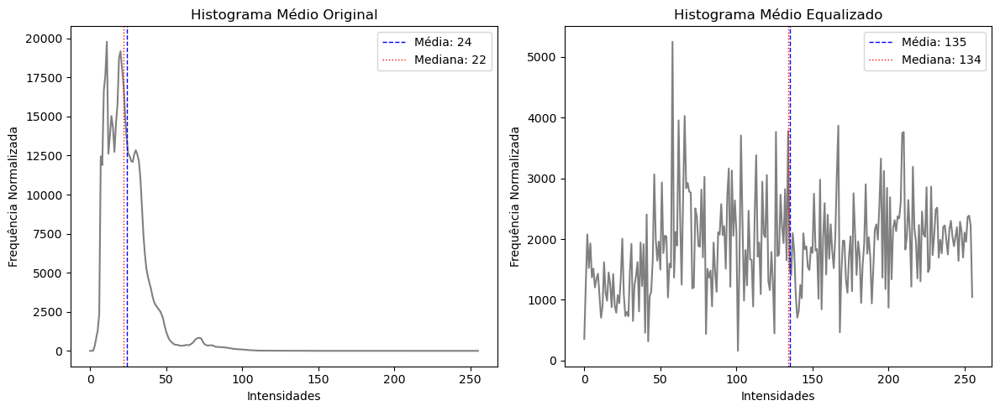

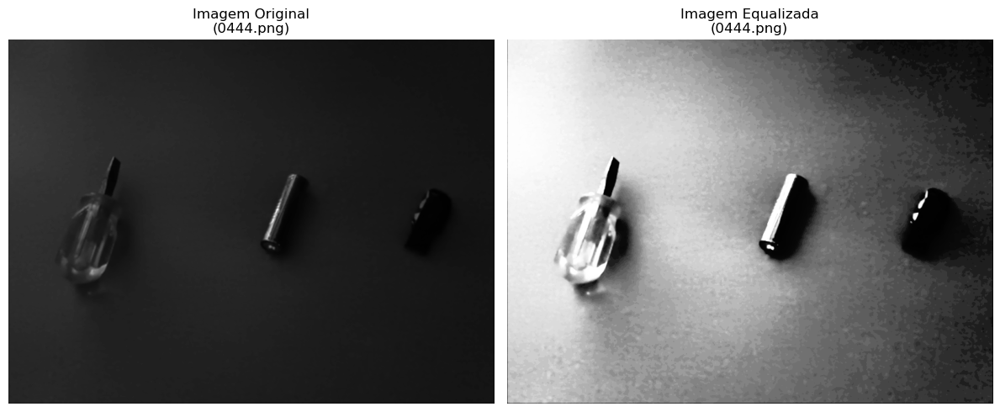

In [39]:
arquivos = metadados[(metadados['Grupo'] == 4) &
                     (metadados['Plano de Fundo'] == 'Cimento') &
                     (metadados['Luz'] == 'Indireta') &
                     (metadados['Ambiente'] == 'Interno')]['Nome Arquivo']
exemplo = np.random.choice(arquivos)
diretorio = agdir + '\\' + subdirs[4]

normaliza_e_mostra(arquivos, exemplo, diretorio)

#### Parte 2.10.5: Fundo: Pedra | Luz: Sol | Ambiente: Externo (grupo 5)

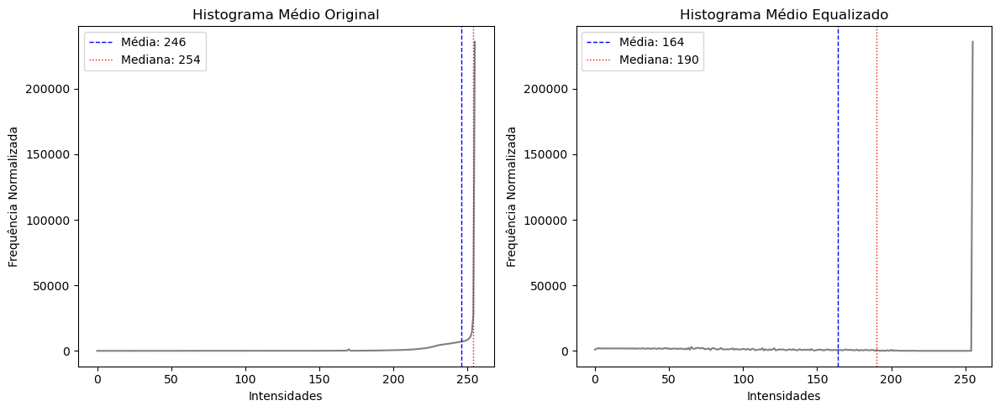

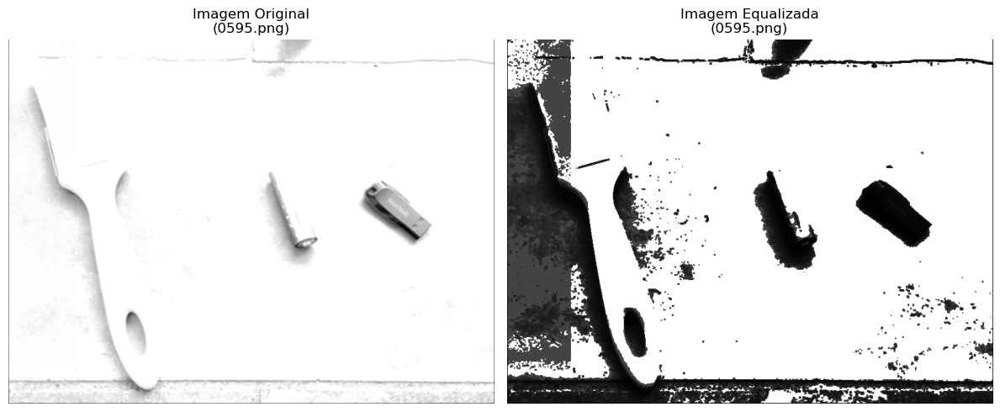

In [40]:
arquivos = metadados[(metadados['Grupo'] == 5) &
                     (metadados['Plano de Fundo'] == 'Pedra') &
                     (metadados['Luz'] == 'Sol') &
                     (metadados['Ambiente'] == 'Externo')]['Nome Arquivo']
exemplo = np.random.choice(arquivos)
diretorio = agdir + '\\' + subdirs[4]

normaliza_e_mostra(arquivos, exemplo, diretorio)

<hr style="border: 0; border-top: 4px solid black; width: 85%; margin: 0 auto;">

## Parte 3: Discussão e Conclusão Sobre os Resultados

A normalização (Equalização do Histograma) aumentou significativamente o contraste em todas as iluminações e transformações. Em alguns casos, os objetos ficaram mais nítidos, mas o fundo também, como no grupo 1 (fundo: madeira, luz: amarela, ambiente: interno) no dataset original (originalGrayDataset). O fundo da imagem e os objetos ficaram muito mais nítidos. Em outros casos, o fundo foi realçado enquanto os objetos perderam nitidez, como nos grupos 2, 3 e 4 (fundo: concreto, luz: sombra, ambiente: externo; fundo: branco, luz: branca, ambiente: interno; fundo: cimento, luz: indireta, ambiente: interno). No grupo 5 (fundo: pedra, luz: sol, ambiente: externo), tanto os objetos quanto as sombras e o fundo apresentaram um aspecto "estourado" ou "preto profundo", dificultando sua interpretação.

Essas alterações também foram evidentes nas transformações, a saber:

* **Contrast Stretching**, **Logarítmica** e **Exponencial**: Praticamente os mesmos resultados do dataset original foram obtidos.
* **Laplaciano**: Os contornos realçados pela transformação ficaram ainda mais evidentes, especialmente os contornos do fundo, como no grupo 1 (fundo: madeira, luz: amarela, ambiente: interno) e no grupo 3 (fundo: branco, luz: branca, ambiente: interno). No grupo 2 (fundo: concreto, luz: sombra, ambiente: externo), o fundo não ficou tão aparente, e nos grupos 4 e 5 (fundo: cimento, luz: indireta, ambiente: interno; fundo: pedra, luz: sol, ambiente: externo), a nitidez geral das fotos foi sensivelmente prejudicada.
* **Média/Suavização**: Todos os 5 grupos apresentaram perda de nitidez, apesar do aumento de contraste.

### Conclusão

A normalização (Equalização do Histograma) e as transformações de imagem aplicadas demonstraram uma sensível variação nos resultados de nitidez e contraste, dependendo das condições de iluminação e do tipo de fundo. Enquanto algumas transformações melhoraram a visibilidade dos contornos e detalhes dos objetos, outras prejudicaram a interpretação ao realçar excessivamente o fundo ou ao "estourar" certas áreas da imagem. É crucial, portanto, selecionar a técnica de processamento adequada ao contexto específico da imagem para obter um resultado útil ou alinhado ao esperado.

### FIM EP2 - Parte 2

<hr style="border: 0; border-top: 10px solid black; width: 85%; margin: 0 auto;">